# Домашнее задание

Data contains the book rating information. Ratings (Book-Rating) are either explicit, expressed on a scale from 1-10 (higher values denoting higher appreciation), or implicit, expressed by 0.

### 1. Реализовать персональный топ  - принимает на вход возраст и локацию, на выходе персональный топ   - 1 балл

Персональный топ - это топ товаров по похожим возрасту/интересам/локации. Как сделать? Разбить на сегменты по выбраным признакам. Топ делать по книгам с хорошим средним рейтингом.

### 2. На основе метода кластеризации похожих пользователей построить рекомендации (Слайд 25) - 2 балла

Нужно топ-10 рекомендаций с самой высокой оценкой. Считаем среднюю оценку для каждой книги по кластеру и выводим топ-10 книг.

### 3. Применить методы расмотренные на лекции (Совстречаемость - 2 балл, Content-based - 1 балл, Коллаборативная фильтрация - 3 балла , Матричная Факторизация - 1 балл) - 7 баллов

В совстречаемости также учитывать оценки. Вес пары книг встретившихся у пользователя - полусумма их оценок

Коллаборативную фильтрацию реализовывать как на слайде 50 презентации, посоветовав каждому пользователю топ-10 книг с самой высокой оценкой. Сделать рекомендации User-based и Item-based и сравнить.

Если совсем сложно - можно сделать как в семинарской части, поставив оценку "0", если рейтинг < 5 и "1" - в противном случае. Тогда максимум за это - 1 балл.

Для Content-based, Коллаборативной фильтрации, Матричной Факторизации реализовать U2I и I2I рекомендации

### Примечание:

Так как пользователей много - можно зафиксировать несколько произвольных и для них уже составлять рекомендации
Работоспособность I2I можно проверять на известных книгах (Гарри Поттер, Властелин Колец, Интервью с вампиром, Код-Да-Винчи, Маленький Принц)
Рейтинг книг обязательно нужно учитывать

Не забываем также предобработать данные - выкинуть выбросы-пользователей и выбросы-книги.

# Дедлайн 30 ноября
# Жесткий дедлайн - 7 декабря

Выводить в качестве рекомендаций лучше названия книг, картинки (если они есть) и соответствующие метрики близости.
Присылать в виде ноутбука


In [1]:
import pandas as pd

books = pd.read_csv("BX-Books.csv", low_memory=False)

In [2]:
books.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...


In [3]:
interactions = pd.read_csv("BX-Book-Ratings.csv", sep=";", encoding = "ISO-8859-1")

In [4]:
interactions = interactions[interactions["Book-Rating"] != 0]

In [5]:
interactions.head()

,User-ID,ISBN,Book-Rating
1,276726,0155061224,5
3,276729,052165615X,3
4,276729,0521795028,6
6,276736,3257224281,8
7,276737,0600570967,6


In [6]:
books_meets = interactions.groupby("ISBN")["User-ID"].count().reset_index().rename(columns={"User-ID": "user_num"})

In [7]:
books_meets.head()

,ISBN,user_num
0,0330299891,1
1,0375404120,1
2,9022906116,1
3,#6612432,1
4,'9607092910',1


In [8]:
user_meets = interactions.groupby("User-ID")["ISBN"].count().reset_index().rename(columns={"ISBN": "books_num"})

In [9]:
user_meets.head()

,User-ID,books_num
0,8,7
1,9,1
2,10,1
3,12,1
4,14,3


In [10]:
interactions = interactions.merge(books_meets, on=["ISBN"]).merge(user_meets, on=["User-ID"])

In [11]:
interactions = interactions[(interactions["user_num"] > 5) & 
                            (interactions["books_num"] > 5) &
                            (interactions["books_num"] < 200)]

In [12]:
interactions.head()

,User-ID,ISBN,Book-Rating,user_num,books_num
5,86583,3404139178,9,8,18
6,86583,3453061187,8,13,18
13,86583,3426609061,7,8,18
8555,16877,038550120X,9,81,10
8556,16877,034539657X,7,26,10


In [13]:
users = pd.read_csv('BX-Users.csv', delimiter=';', encoding = 'ISO-8859-1')

In [14]:
users.head()

,User-ID,Location,Age
0,1,"nyc, new york, usa",NaN
1,2,"stockton, california, usa",18.0
2,3,"moscow, yukon territory, russia",NaN
3,4,"porto, v.n.gaia, portugal",17.0
4,5,"farnborough, hants, united kingdom",NaN


In [15]:
interactions = interactions.merge(books[["ISBN", "Image-URL-M", "Book-Title"]].rename(
    columns={"Image-URL-M": "picture_url"}), on=["ISBN"])

In [16]:
interactions.head()

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman
1,132500,3404139178,10,8,43,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman
2,66483,3404139178,10,8,83,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman
3,276866,3404139178,9,8,11,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman
4,106534,3404139178,6,8,6,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman


In [17]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()

In [18]:
interactions["product_id"] = le.fit_transform(interactions["ISBN"])
interactions["vid"] = le.fit_transform(interactions["User-ID"])

In [19]:
interactions.head()

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,product_id,vid
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,3445
1,132500,3404139178,10,8,43,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,5248
2,66483,3404139178,10,8,83,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,2622
3,276866,3404139178,9,8,11,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,10887
4,106534,3404139178,6,8,6,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,4228


In [20]:
from scipy.sparse import coo_matrix, csr_matrix

csr_rates = coo_matrix((interactions["Book-Rating"], (interactions["vid"], interactions["product_id"])), 
                            shape=(len(set(interactions["vid"])), len(set(interactions["product_id"]))))

### Ищем id нужных книг

In [21]:
for i, j in interactions[["product_id", "Book-Title"]].drop_duplicates().values:
    if "David Copperfield" in j:
        print("idx:", i, "\tBook Title:", j)

idx: 10174 	Book Title: David Copperfield (Wordsworth Classics)
idx: 1074 	Book Title: David Copperfield (Penguin Classics)


# Задание 1

Реализовать персональный топ  - принимает на вход возраст и локацию, на выходе персональный топ   - 1 балл

Персональный топ - это топ товаров по похожим возрасту/интересам/локации. Как сделать? Разбить на сегменты по выбраным признакам. Топ делать по книгам с хорошим средним рейтингом.

In [22]:
import matplotlib.pyplot as plt
from PIL import Image
import requests
from io import BytesIO
import numpy as np

In [334]:
def chunks(l, n):
    for i in range(0, len(l), n):
        yield l[i:i + n]

def rec_imaging(product_ids, content_dict, measure=None, top_n=5):
    picture_urls = [content_dict[i] for i in product_ids]
    cnt = 0
    for idx, chunk in enumerate(chunks(picture_urls, top_n)):
        fig = plt.figure(figsize=(20, 4))
        for n, i in enumerate(chunk):
            try:
                r = requests.get(i)
                im = Image.open(BytesIO(r.content))

            except:
                print('Something went wrong with {url}'.format(url=i))
                continue

            a = fig.add_subplot(1, top_n, n + 1)
            if measure is not None:
                a.title.set_text("measure = {}".format(np.round(measure[cnt], 4)))
                cnt += 1
            plt.imshow(im)
            plt.axis('off')
        plt.show()

Разбиваю локацию на города и страны:

In [24]:
cities = []
countries = []
for location in users.Location:
    s = location.split(', ')
    cities.append(s[0])
    countries.append(s[-1])

In [25]:
users['city'] = cities
users['country'] = countries

Считаю для каждой книги (которая есть в interactions) средний рейтинг:

In [26]:
books['Book-Rating'] = books.apply(lambda _: np.nan, axis=1)

In [27]:
interactions.ISBN.value_counts().index

Index(['0316666343', '0385504209', '0971880107', '0312195516', '0142001740',
       '059035342X', '0060928336', '0446672211', '0671027360', '0345337662',
       ...
       '0767904141', '0743430344', '3257204981', '0849943124', '3404135091',
       '0316418374', '0525935878', '0440977096', '0439104645', '8804342838'],
      dtype='object', length=10712)

In [28]:
for ISBN in interactions.ISBN.value_counts().index:
    book = interactions[interactions.ISBN == ISBN]
    book_rating = book['Book-Rating'].mean()
    books.loc[books[books.ISBN == ISBN].index[0], 'Book-Rating'] = book_rating
    index = interactions[interactions.ISBN == ISBN].index
    interactions.loc[index, 'Average Book-Rating'] = book_rating

In [173]:
books['Book-Rating'].value_counts().index.sort_values()

Float64Index([              1.0,               2.5,              2.75,
                            3.0,               3.5,               3.8,
                            4.0, 4.029535864978903,               4.2,
              4.333333333333333,
              ...
                           9.75,  9.76923076923077,               9.8,
              9.818181818181818, 9.833333333333334, 9.857142857142858,
                          9.875,               9.9, 9.916666666666666,
                           10.0],
             dtype='float64', length=963)

Буду считать хорошим рейтингом тот, среднее значение которого больше 6:

In [174]:
interactions_ = interactions[interactions['Average Book-Rating'] >= 6]

Выкину выбросы среди пользователей. Буду считать, что книги могут купить дети с 6 лет. Также людей старше 100 лет также выкину из выборки.

In [175]:
babies = users[users.Age < 6].Age.index
long_livers = users[users.Age > 100].Age.index

In [176]:
users = users.drop(babies)
users = users.drop(long_livers)

Среди книг выброшу те, которые выпущены в будущем:

In [177]:
future_books = books[books['Year-Of-Publication'] > '2020'].index
books = books.drop(future_books)

Книги, которые выпущены до 1900 года, тоже выкину (конечно они могут существовать, но вряд ли продаются).

In [178]:
ancient_books = books[books['Year-Of-Publication'] < '1900'].index
books = books.drop(ancient_books)

Реализую функцию, которая на входе получает возраст и локацию, а на выходе персональный топ:

In [34]:
def top(age, location):
    a = users[users.Age > age - 5] # категория людей, которым больше (возраст -  5) лет 
    b = users[users.Age < age + 5] # категория людей, которым меньше (возраст + 5) лет
    c = pd.merge(a, b, on=['User-ID', 
                           'Location',
                           'Age', 'city', 'country']) # категория людей, которым от (возраст-5) лет до (возраст+5) лет
    s = location.split(sep=', ') # делю локацию на страну и город (у некоторых присутствует штат)
    d = users[users.country == s[-1]] # категория людей, проживающая в той стране, в которой находится заданная локация
    e = pd.merge(c, d, on=['User-ID',
                           'Location',
                           'Age', 'city', 'country']) # пользователи, живущие в одной стране и похожие по возрасту
    f = pd.merge(e, interactions_, on='User-ID') # поиск пользователей в матрице interections_
    index = f['Average Book-Rating'].sort_values(ascending=False)[:30].index
    product_id_to_url = {}
    for i in f[["product_id", "picture_url"]].drop_duplicates().values:
        product_id_to_url[i[0]] = i[1]
    rec_imaging(f.iloc[index].product_id.drop_duplicates().values, product_id_to_url)

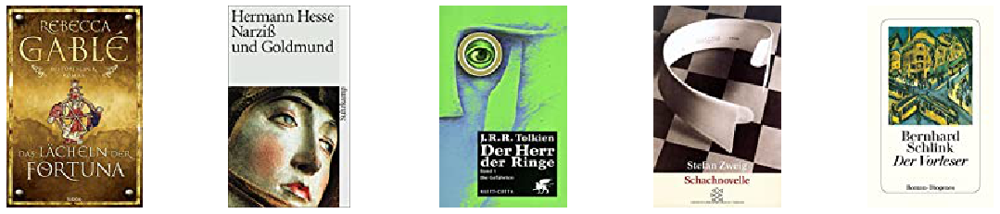

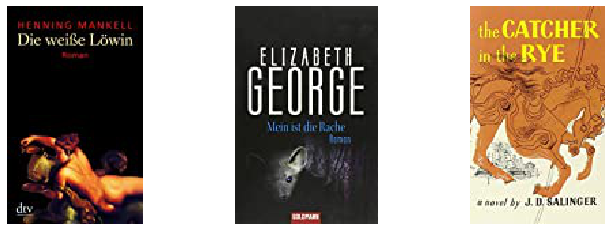

In [35]:
top(18, 'pratteln, baselland, switzerland')

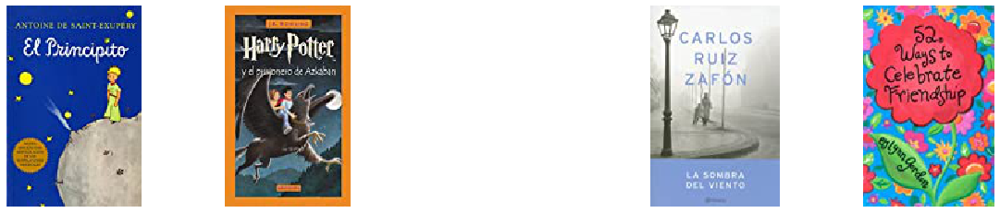

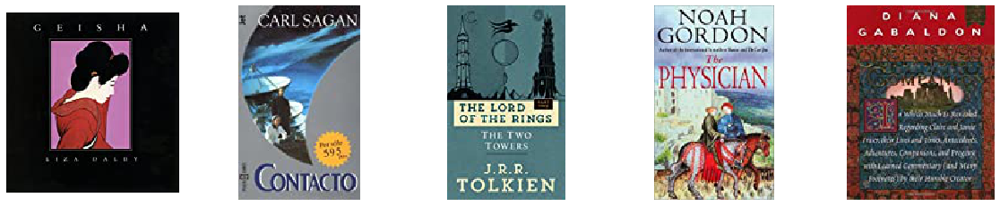

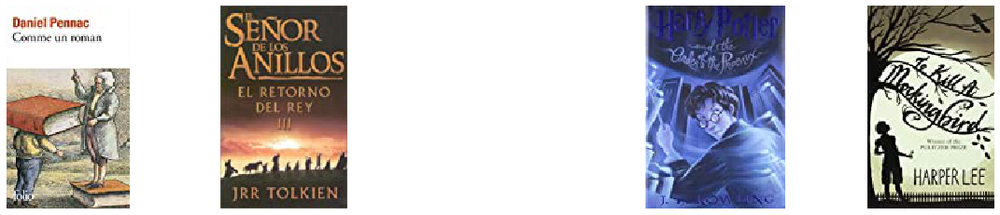

In [36]:
top(26, 'barcelona, barcelona, spain')

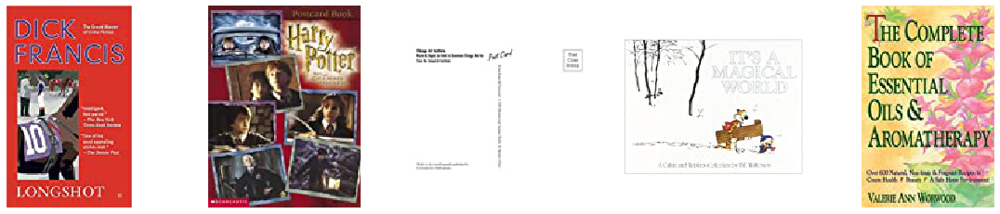

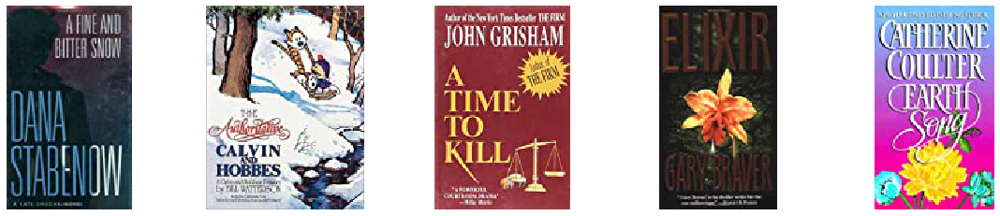

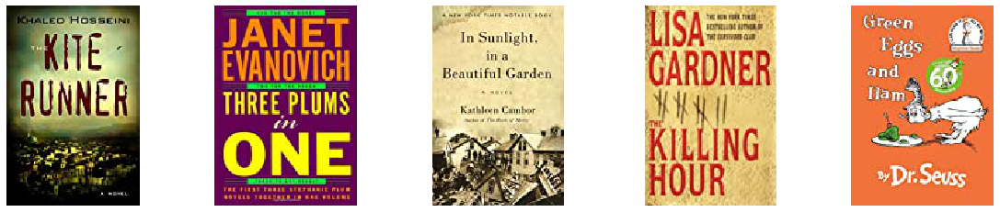

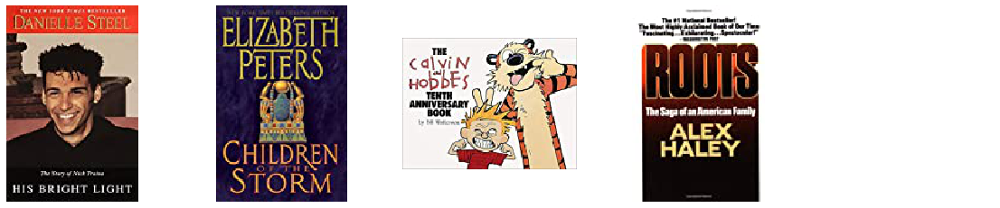

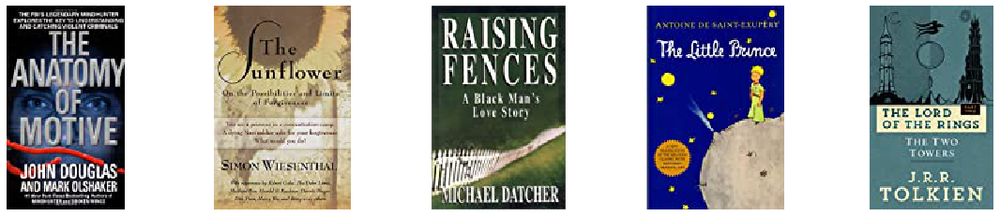

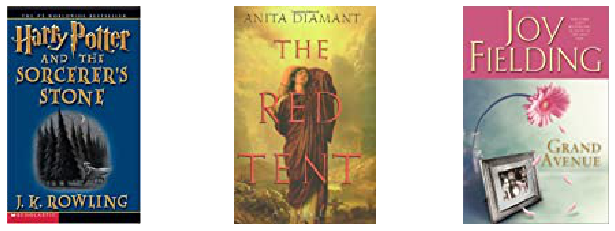

In [37]:
top(61, 'santa monica, california, usa')

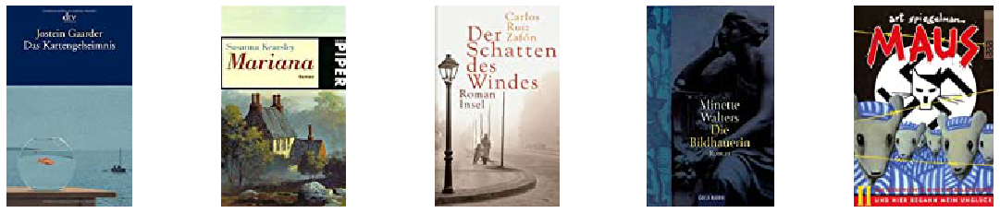

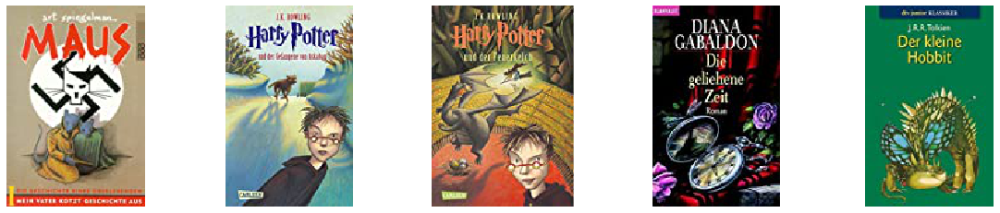

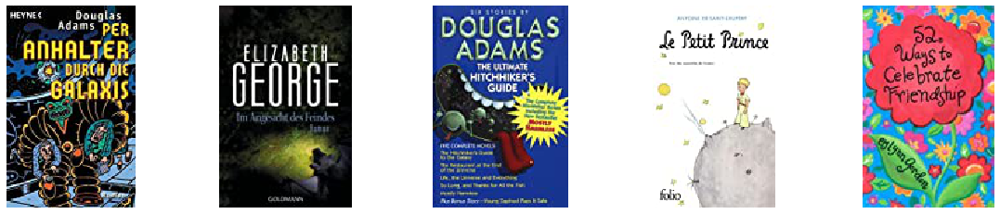

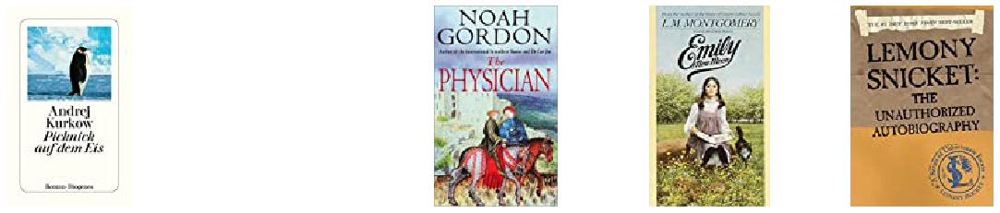

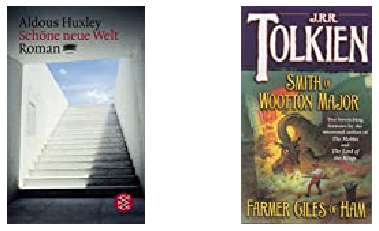

In [38]:
top(24, 'freiburg, baden-wuerttemberg, germany')

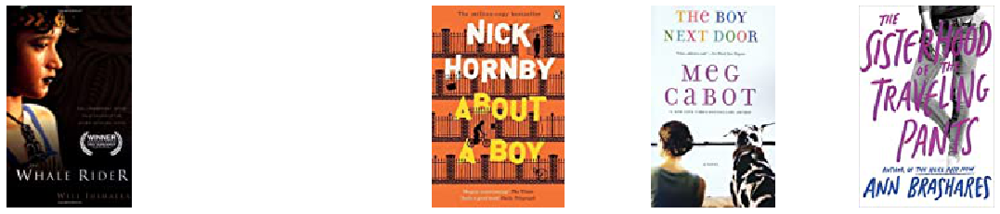

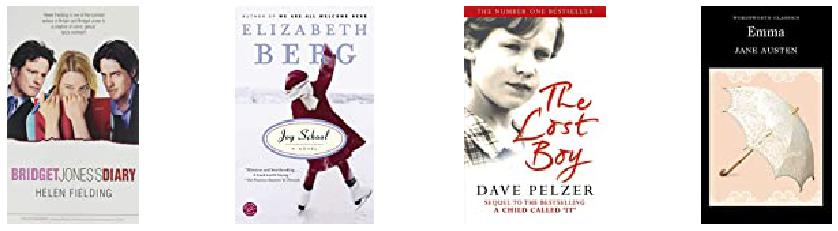

In [39]:
top(18, 'tokyo, tokyo, japan')

# Задание 2
На основе метода кластеризации похожих пользователей построить рекомендации (Слайд 25) - 2 балла

Нужно топ-10 рекомендаций с самой высокой оценкой. Считаем среднюю оценку для каждой книги по кластеру и выводим топ-10 книг.

В качестве меры схожести выберу косинусную меру.

In [34]:
from scipy.spatial.distance import cdist

In [35]:
csr_rates_ = csr_rates.toarray()

In [36]:
measure = cdist(csr_rates_, csr_rates_, metric='cosine')
measure

array([[0.00000000e+00, 1.00000000e+00, 1.00000000e+00, ...,
        1.00000000e+00, 1.00000000e+00, 1.00000000e+00],
       [1.00000000e+00, 0.00000000e+00, 1.00000000e+00, ...,
        1.00000000e+00, 1.00000000e+00, 1.00000000e+00],
       [1.00000000e+00, 1.00000000e+00, 1.11022302e-16, ...,
        1.00000000e+00, 1.00000000e+00, 1.00000000e+00],
       ...,
       [1.00000000e+00, 1.00000000e+00, 1.00000000e+00, ...,
        0.00000000e+00, 1.00000000e+00, 1.00000000e+00],
       [1.00000000e+00, 1.00000000e+00, 1.00000000e+00, ...,
        1.00000000e+00, 0.00000000e+00, 1.00000000e+00],
       [1.00000000e+00, 1.00000000e+00, 1.00000000e+00, ...,
        1.00000000e+00, 1.00000000e+00, 0.00000000e+00]])

Создам матрицу косинусных расстояний:

In [37]:
measure = 1 - measure
measure

array([[1., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 0., 1.]])

In [51]:
def clustering_recommendation(user_id):
    vid = interactions[interactions['User-ID'] == user_id].vid.values[0] # ищем индекс пользователя для матрицы косинусных
                                                                  # расстояний
    df = pd.DataFrame(measure[vid], columns=['cosine']) # формирую датасет для пользователя с косинусными расстояниями
    index = df[df.cosine != 0].cosine.sort_values(ascending=False)[:10].index # выбор близжайших 10 соседей
    interac = interactions.loc[interactions['vid'].isin(index)] # нахождение соседей в матрице interactions
    books_ = interac.ISBN.value_counts().index # индексы книг в матрице intaeractions, которые прочитали пользователи
    for book in books_:
        rating = interac[interac.ISBN == book]['Book-Rating'].mean() # средний рейтинг книги по кластеру
        ind = interac[interac.ISBN == book].index # индекс книги в матрице interac
        interac.loc[ind, 'Average Book-Rating'] = rating # добавление в матрицу interac признака средний рейтинг
    data = interac[['ISBN', 'product_id', 'picture_url', 'Average Book-Rating']].drop_duplicates()
    index_ = data['Average Book-Rating'].sort_values(ascending=False)[:10].index # топ 10 книг по кластеру
    product_id_to_url = {}
    for i in data[["product_id", "picture_url"]].drop_duplicates().values:
        product_id_to_url[i[0]] = i[1]
    print(u"Для пользователя, который оценил книги")
    rec_imaging(interactions[interactions['User-ID'] == user_id].product_id.values, product_id_to_url,
                interactions[interactions['User-ID'] == user_id]['Book-Rating'].values)
    print(u"Такие рекомендации")
    rec_imaging(data.loc[index_].product_id.drop_duplicates().values, product_id_to_url, 
                data.loc[index_]['Average Book-Rating'].values)

Для пользователя, который оценил книги


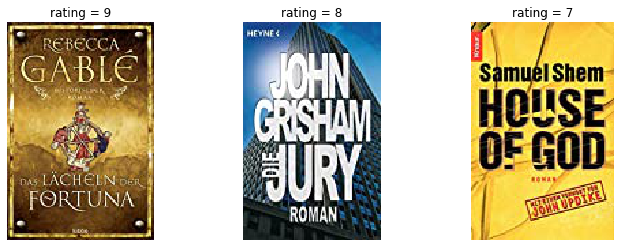

Такие рекомендации


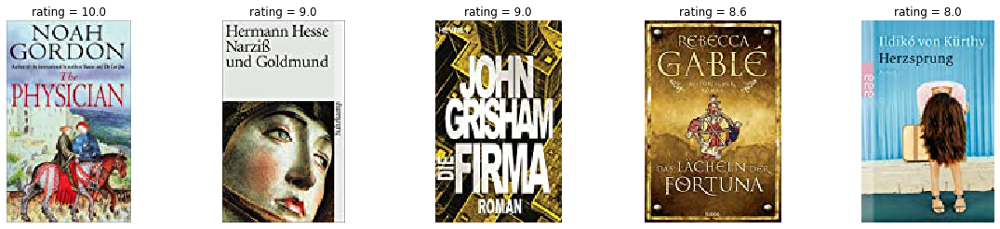

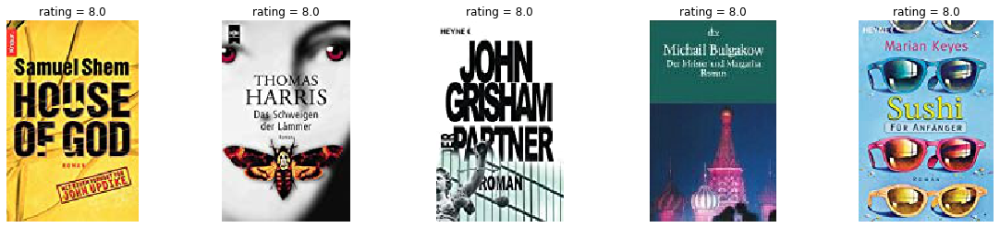

In [52]:
clustering_recommendation(86583)

Для пользователя, который оценил книги


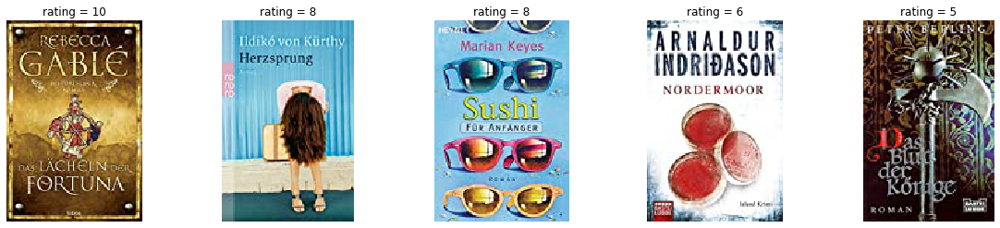

Такие рекомендации


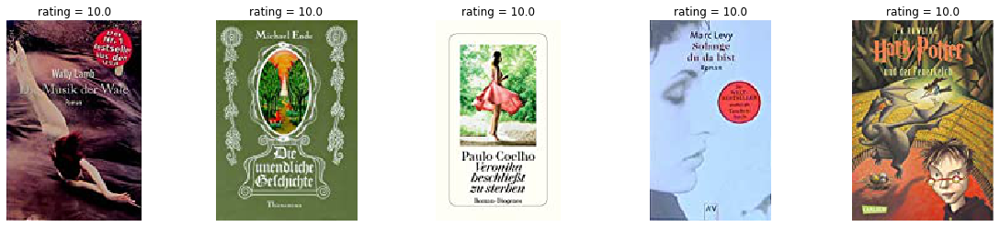

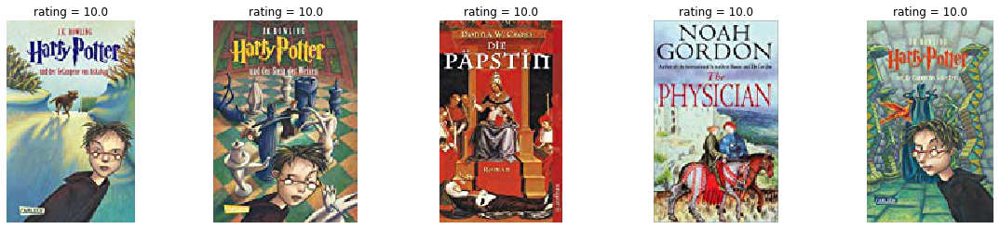

In [53]:
clustering_recommendation(132500)

Для пользователя, который оценил книги


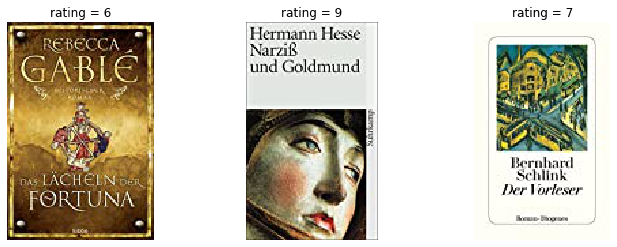

Такие рекомендации


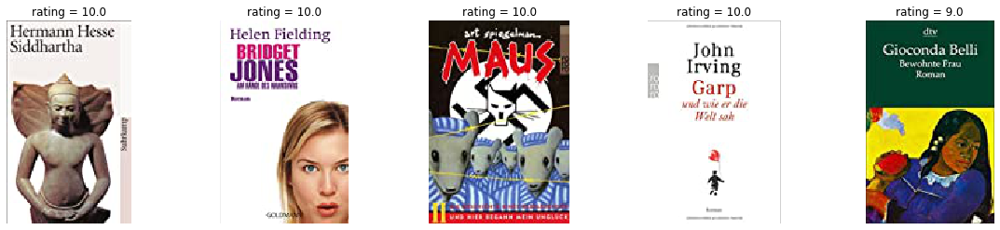

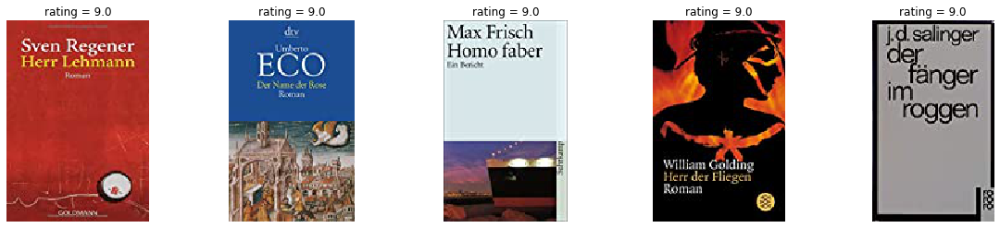

In [72]:
clustering_recommendation(106534)

Для пользователя, который оценил книги


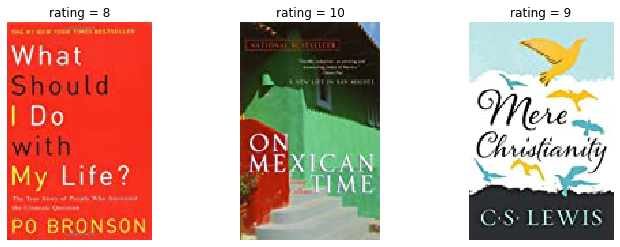

Такие рекомендации


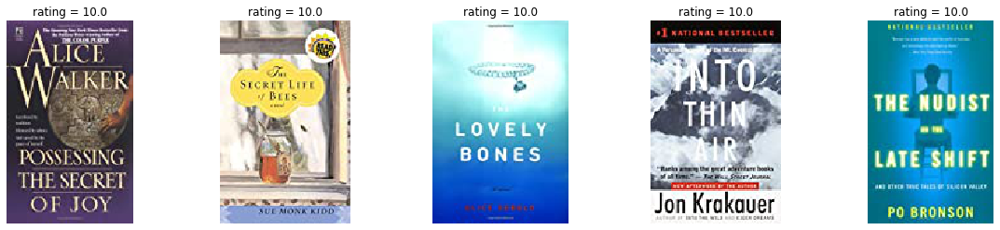

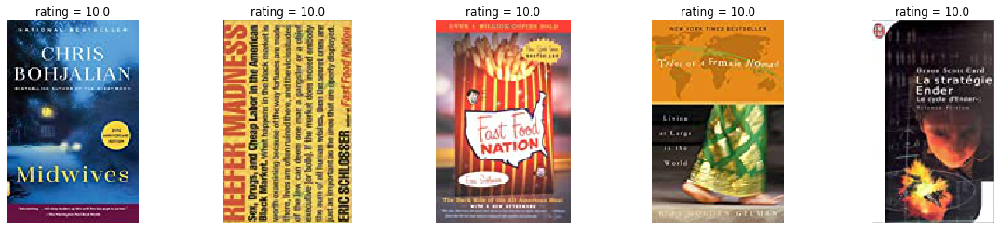

In [55]:
clustering_recommendation(94153)

Для пользователя, который оценил книги


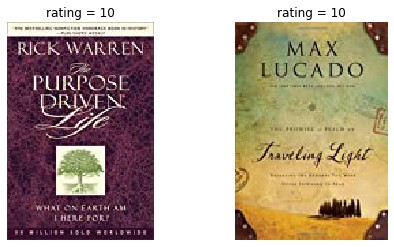

Такие рекомендации


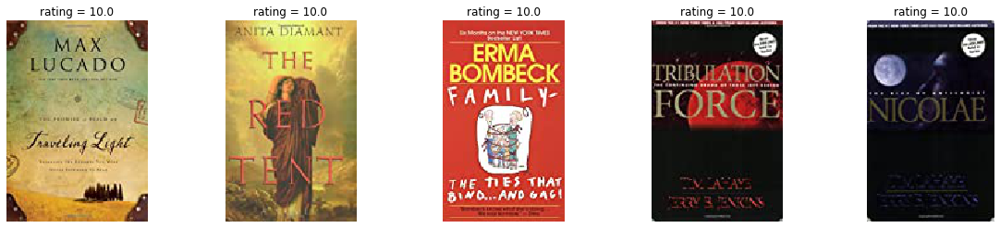

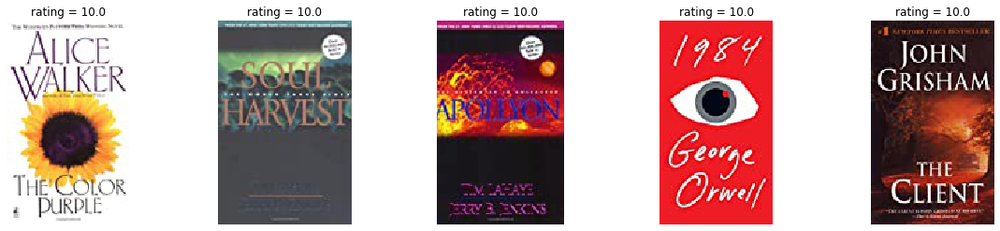

In [56]:
clustering_recommendation(27551)

# Задание 3
Применить методы расмотренные на лекции (Совстречаемость - 2 балл, Content-based - 1 балл, Коллаборативная фильтрация - 3 балла , Матричная Факторизация - 1 балл) - 7 баллов

## Совстречаемость
В совстречаемости также учитывать оценки. Вес пары книг встретившихся у пользователя - полусумма их оценок

In [113]:
import tqdm

ID пользователей, которые оценили более 1 книги:

In [65]:
user_meets_ = interactions.groupby("User-ID")["ISBN"].count().reset_index().rename(columns={"ISBN": "books_num"})

In [69]:
IDs = user_meets_[user_meets_.books_num > 1]['User-ID'].values

In [192]:
cooc = {} # словарь, ключом которого является пара ISBN, а значением вес этой пары
for ID in tqdm.notebook.tqdm(IDs): # цикл по пользователям, оценивших более одной книги
    interac = interactions[interactions['User-ID'] == ID]
    ISBNs = interac.ISBN.values
    for ISBN_1 in ISBNs:
        for ISBN_2 in ISBNs:
            if ISBN_1 != ISBN_2:
                if (ISBN_1 + '_' + ISBN_2) in cooc:
                    rating_i = interac[interac.ISBN == ISBN_1]['Book-Rating'].values[0]
                    rating_j = interac[interac.ISBN == ISBN_2]['Book-Rating'].values[0]
                    cooc[ISBN_1 + '_' + ISBN_2] += (rating_i + rating_j) / 2
                else:
                    rating_i = interac[interac.ISBN == ISBN_1]['Book-Rating'].values[0]
                    rating_j = interac[interac.ISBN == ISBN_2]['Book-Rating'].values[0]
                    cooc[ISBN_1 + '_' + ISBN_2] = (rating_i + rating_j) / 2

In [193]:
cooc_list = []
for i, j in cooc.items():
    cooc_list.append(i.split("_") + [j])

In [194]:
cooc_rec = pd.DataFrame(cooc_list, columns=["book1", "book2", "weight"])
cooc_rec.head()

,book1,book2,weight
0,0451166892,0446677450,6.5
1,0451166892,0312252617,5.5
2,0451166892,0312261594,5.5
3,0451166892,0316748641,5.0
4,0446677450,0451166892,6.5


In [199]:
def coocurrency_recomendation(ISBN):
    recs = cooc_rec[cooc_rec["book1"] == ISBN]\
                            .sort_values("weight", ascending=False)\
                            .head(10)
    book_id = recs.book2.values
    book_id = np.append(book_id, ISBN)
    interac = interactions.loc[interactions['ISBN'].isin(book_id)]
    product_id_to_url = {}
    for i in interac[["product_id", "picture_url"]].drop_duplicates().values:
        product_id_to_url[i[0]] = i[1]
    print(u"Для книги")
    rec_imaging([interac[interac.ISBN == ISBN].product_id.values[0]], product_id_to_url)
    print(u"Такие рекомендации")
    ids = interac.loc[interac['ISBN'].isin(recs["book2"].values)].product_id.value_counts().index
    rec_imaging(ids, product_id_to_url, recs["weight"].values.astype(int))

Для книги


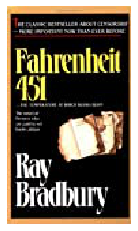

Такие рекомендации


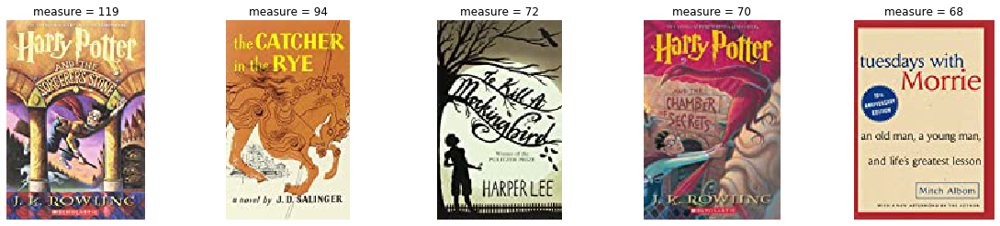

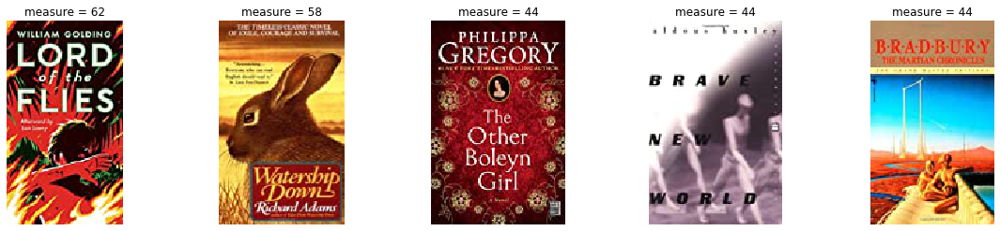

In [220]:
coocurrency_recomendation('0345342968')

Для книги


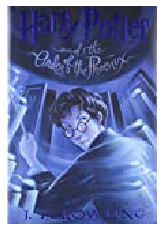

Такие рекомендации


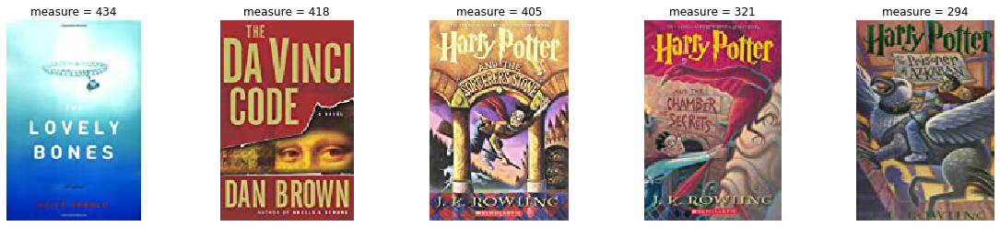

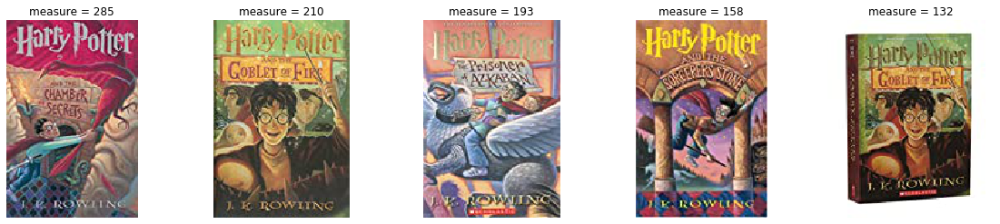

In [221]:
coocurrency_recomendation('043935806X')

Для книги


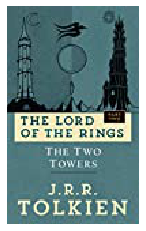

Такие рекомендации


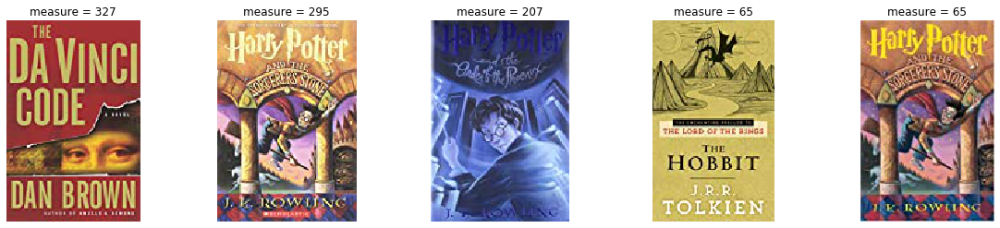

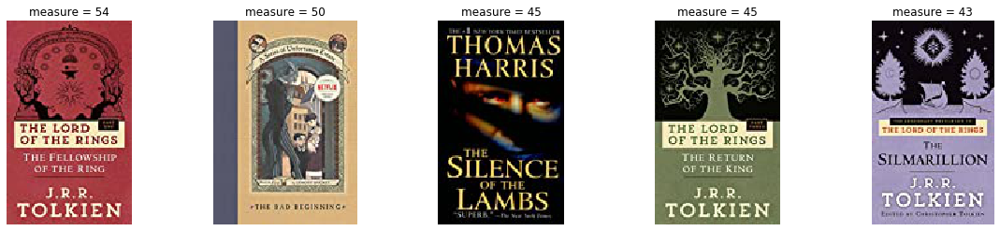

In [253]:
coocurrency_recomendation('0345339711')

Для книги


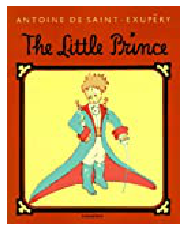

Такие рекомендации


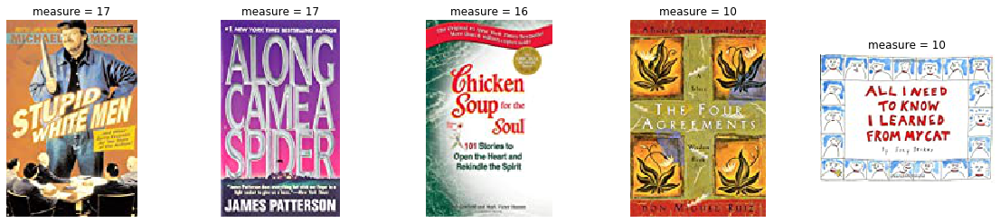

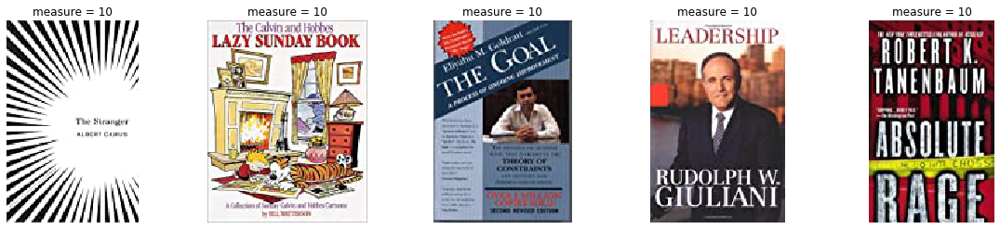

In [249]:
coocurrency_recomendation('0156465116')

Для книги


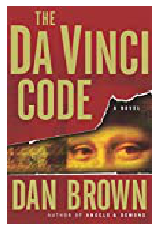

Такие рекомендации


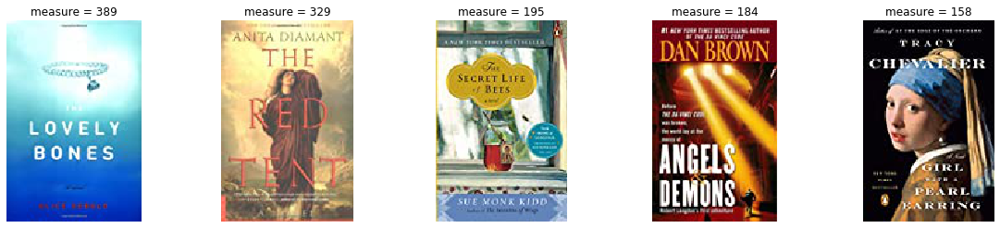

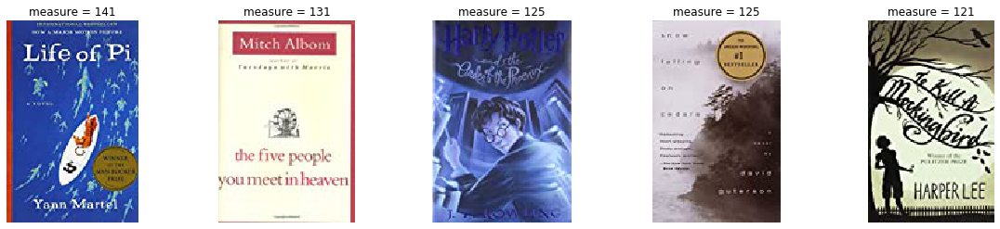

In [255]:
coocurrency_recomendation('0385504209')

## Content-based
Для Content-based, Коллаборативной фильтрации, Матричной Факторизации реализовать U2I и I2I рекомендации

In [29]:
df_books = interactions[['ISBN', 'picture_url', 'Book-Title', 'product_id', 'Average Book-Rating']].drop_duplicates()
df_books.columns = ['ISBN', 'Image-URL-M', 'Book-Title', 'product_id', 'Book-Rating']
df_books.head()

,ISBN,Image-URL-M,Book-Title,product_id,Book-Rating
0,3404139178,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,8.833333
6,3453061187,http://images.amazon.com/images/P/3453061187.0...,Die Jury. Roman.,10495,7.857143
13,3426609061,http://images.amazon.com/images/P/3426609061.0...,House Of God.,10428,5.333333
19,038550120X,http://images.amazon.com/images/P/038550120X.0...,A Painted House,3452,7.846154
71,034539657X,http://images.amazon.com/images/P/034539657X.0...,Dark Rivers of the Heart,2103,7.352941


In [30]:
df_books = pd.merge(df_books, books, on=['ISBN', 'Book-Title', 'Image-URL-M', 'Book-Rating'])
df_books.head()

,ISBN,Image-URL-M,Book-Title,product_id,Book-Rating,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-L
0,3404139178,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,8.833333,Rebecca Gable,1997,LÃ?Â¼bbe,http://images.amazon.com/images/P/3404139178.0...,http://images.amazon.com/images/P/3404139178.0...
1,3453061187,http://images.amazon.com/images/P/3453061187.0...,Die Jury. Roman.,10495,7.857143,John Grisham,1992,Heyne,http://images.amazon.com/images/P/3453061187.0...,http://images.amazon.com/images/P/3453061187.0...
2,3426609061,http://images.amazon.com/images/P/3426609061.0...,House Of God.,10428,5.333333,Samuel Shem,1998,"Droemersche Verlagsanstalt Th. Knaur Nachf., G...",http://images.amazon.com/images/P/3426609061.0...,http://images.amazon.com/images/P/3426609061.0...
3,038550120X,http://images.amazon.com/images/P/038550120X.0...,A Painted House,3452,7.846154,JOHN GRISHAM,2001,Doubleday,http://images.amazon.com/images/P/038550120X.0...,http://images.amazon.com/images/P/038550120X.0...
4,034539657X,http://images.amazon.com/images/P/034539657X.0...,Dark Rivers of the Heart,2103,7.352941,Dean R. Koontz,1995,Ballantine Books,http://images.amazon.com/images/P/034539657X.0...,http://images.amazon.com/images/P/034539657X.0...


In [31]:
df_books.loc[:, 'text'] = df_books['Book-Title'] + ' ' + df_books['Book-Author'] + ' ' + df_books['Publisher']
df_books.head()

,ISBN,Image-URL-M,Book-Title,product_id,Book-Rating,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-L,text
0,3404139178,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,8.833333,Rebecca Gable,1997,LÃ?Â¼bbe,http://images.amazon.com/images/P/3404139178.0...,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman Re...
1,3453061187,http://images.amazon.com/images/P/3453061187.0...,Die Jury. Roman.,10495,7.857143,John Grisham,1992,Heyne,http://images.amazon.com/images/P/3453061187.0...,http://images.amazon.com/images/P/3453061187.0...,Die Jury. Roman. John Grisham Heyne
2,3426609061,http://images.amazon.com/images/P/3426609061.0...,House Of God.,10428,5.333333,Samuel Shem,1998,"Droemersche Verlagsanstalt Th. Knaur Nachf., G...",http://images.amazon.com/images/P/3426609061.0...,http://images.amazon.com/images/P/3426609061.0...,House Of God. Samuel Shem Droemersche Verlagsa...
3,038550120X,http://images.amazon.com/images/P/038550120X.0...,A Painted House,3452,7.846154,JOHN GRISHAM,2001,Doubleday,http://images.amazon.com/images/P/038550120X.0...,http://images.amazon.com/images/P/038550120X.0...,A Painted House JOHN GRISHAM Doubleday
4,034539657X,http://images.amazon.com/images/P/034539657X.0...,Dark Rivers of the Heart,2103,7.352941,Dean R. Koontz,1995,Ballantine Books,http://images.amazon.com/images/P/034539657X.0...,http://images.amazon.com/images/P/034539657X.0...,Dark Rivers of the Heart Dean R. Koontz Ballan...


In [32]:
df_books = df_books[['ISBN', 'Image-URL-M', 'product_id', 'Book-Rating', 'text']]
df_books.head()

,ISBN,Image-URL-M,product_id,Book-Rating,text
0,3404139178,http://images.amazon.com/images/P/3404139178.0...,10397,8.833333,Das Lacheln der Fortuna: Historischer Roman Re...
1,3453061187,http://images.amazon.com/images/P/3453061187.0...,10495,7.857143,Die Jury. Roman. John Grisham Heyne
2,3426609061,http://images.amazon.com/images/P/3426609061.0...,10428,5.333333,House Of God. Samuel Shem Droemersche Verlagsa...
3,038550120X,http://images.amazon.com/images/P/038550120X.0...,3452,7.846154,A Painted House JOHN GRISHAM Doubleday
4,034539657X,http://images.amazon.com/images/P/034539657X.0...,2103,7.352941,Dark Rivers of the Heart Dean R. Koontz Ballan...


In [33]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [34]:
import re

In [35]:
regex = re.compile(u"[А-Яа-яA-Za-z]+") # буду считать, что umlaut и подобные буквы на качество особо не повлияют

def words_only(text, regex=regex):
    return " ".join(regex.findall(text))

df_books.text = df_books.text.str.lower()
df_books.loc[:, 'text'] = df_books.text.apply(words_only)

In [36]:
df_books.head()

,ISBN,Image-URL-M,product_id,Book-Rating,text
0,3404139178,http://images.amazon.com/images/P/3404139178.0...,10397,8.833333,das lacheln der fortuna historischer roman reb...
1,3453061187,http://images.amazon.com/images/P/3453061187.0...,10495,7.857143,die jury roman john grisham heyne
2,3426609061,http://images.amazon.com/images/P/3426609061.0...,10428,5.333333,house of god samuel shem droemersche verlagsan...
3,038550120X,http://images.amazon.com/images/P/038550120X.0...,3452,7.846154,a painted house john grisham doubleday
4,034539657X,http://images.amazon.com/images/P/034539657X.0...,2103,7.352941,dark rivers of the heart dean r koontz ballant...


In [37]:
from nltk.corpus import stopwords

In [38]:
stopwords = stopwords.words('russian') + stopwords.words('english') + stopwords.words('german') + stopwords.words('french')
tfidf = TfidfVectorizer(stop_words=stopwords)
tfidf_matrix = tfidf.fit_transform(df_books['text'])

In [39]:
tfidf_matrix = tfidf_matrix.toarray()

In [36]:
from sklearn.metrics.pairwise import cosine_similarity

In [41]:
cosine = cosine_similarity(tfidf_matrix, tfidf_matrix)
cosine

array([[1.        , 0.13342074, 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.13342074, 1.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 1.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 1.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 1.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        1.        ]])

In [42]:
def CB_i2i(ISBN):
    i = df_books[df_books.ISBN == ISBN].index[0]
    df = pd.DataFrame(cosine[i], columns=['cosine'])
    index = df[df.cosine != 0].cosine.sort_values(ascending=False)[:11].index.drop(i)
    product_id_to_url = {}
    for i in df_books[["product_id", "Image-URL-M"]].drop_duplicates().values:
        product_id_to_url[i[0]] = i[1]
    print(u"Для книги")
    rec_imaging(df_books[df_books.ISBN == ISBN].product_id.values, product_id_to_url)
    print(u"Такие рекомендации")
    rec_imaging(df_books.iloc[index].product_id.values, product_id_to_url, df.iloc[index].values.reshape(10,))

Для книги


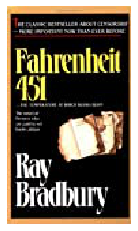

Такие рекомендации


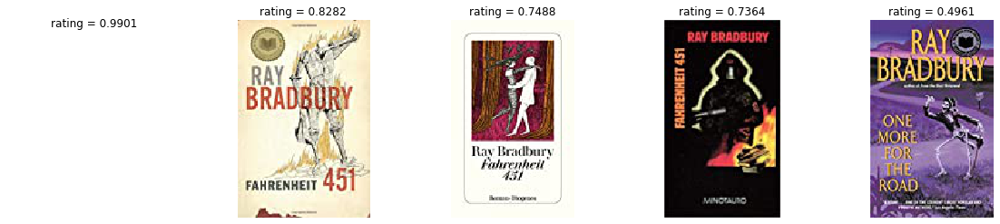

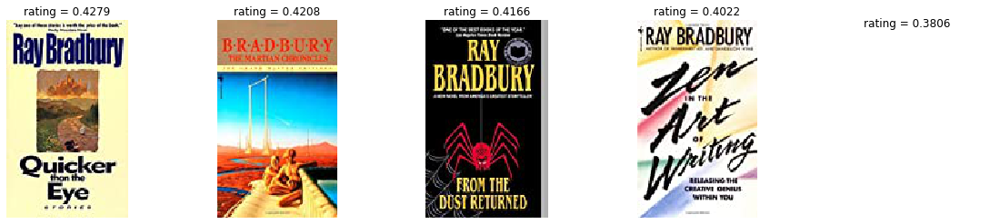

In [43]:
CB_i2i('0345342968')

Для книги


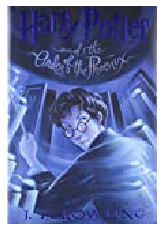

Такие рекомендации


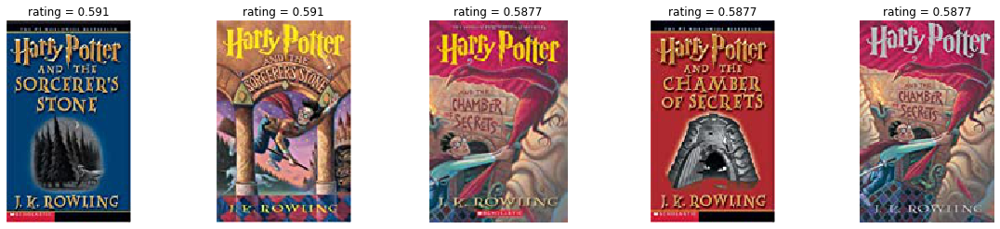

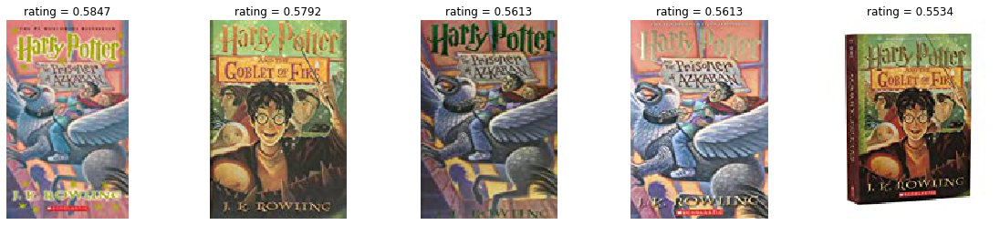

In [44]:
CB_i2i('043935806X')

Для книги


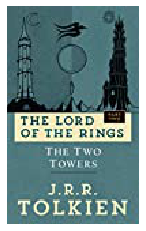

Такие рекомендации


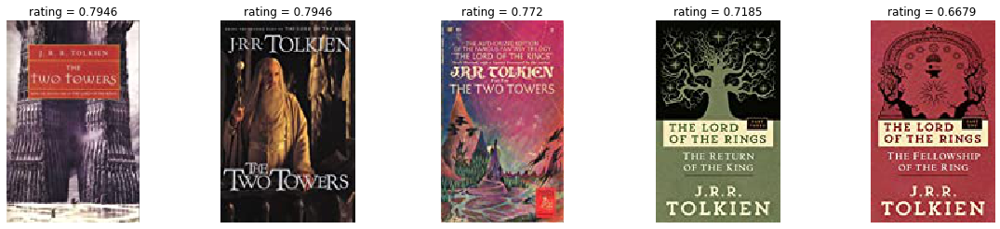

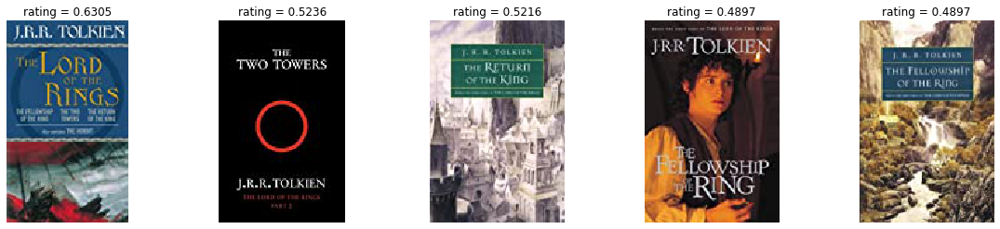

In [45]:
CB_i2i('0345339711')

Для книги


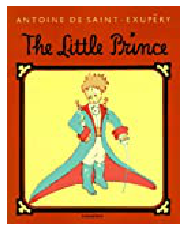

Такие рекомендации


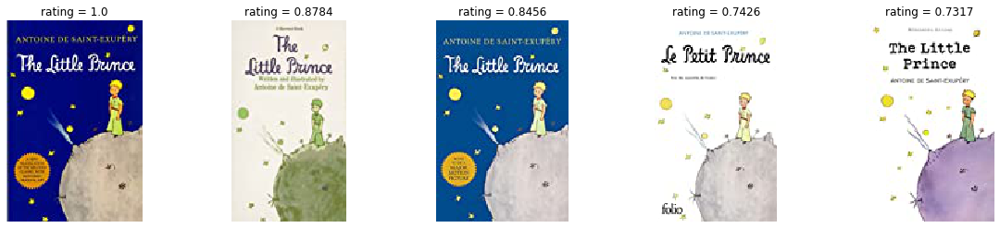

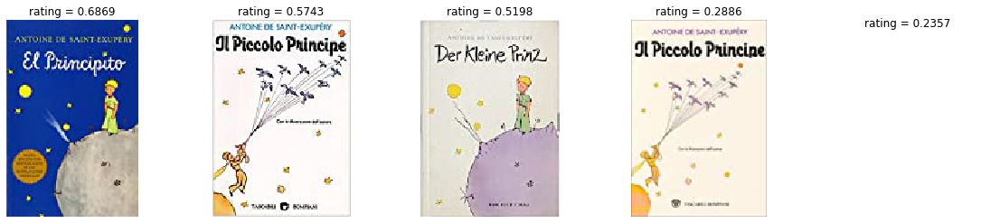

In [46]:
CB_i2i('0156465116')

Для книги


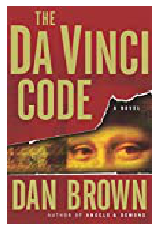

Такие рекомендации


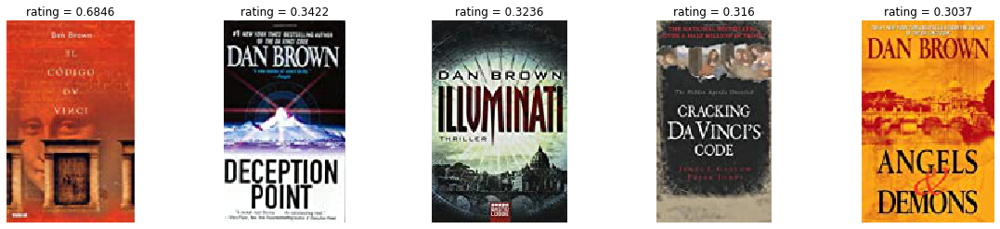

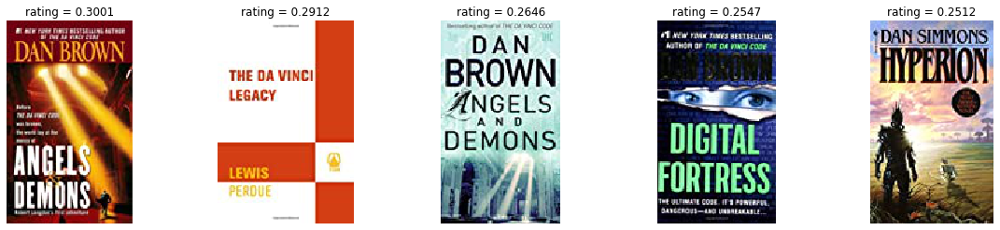

In [47]:
CB_i2i('0385504209')

Вместо рейтинга указана косинусная мера близости между книгами.

In [48]:
def CB_u2i(user_id):
    Int = interactions[interactions['User-ID'] == user_id]
    measure_ = pd.Series([], dtype=pd.StringDtype())
    for j in Int.index:
        book = df_books[df_books.ISBN == Int.loc[j].ISBN]
        i = book.index[0]
        df = pd.DataFrame(cosine[i], columns=['cosine']) * Int.loc[j]['Book-Rating']
        measure_ = measure_.append(df[df.cosine != 0].cosine.sort_values(ascending=False)[:11].drop(i))
    index = measure_.sort_values(ascending=False).index[:10]
    product_id_to_url = {}
    for i in df_books[["product_id", "Image-URL-M"]].drop_duplicates().values:
        product_id_to_url[i[0]] = i[1]
    print(u"Для пользователя, который оценил книги")
    rec_imaging(Int.product_id.values, product_id_to_url, Int['Book-Rating'].values)
    print(u"Такие рекомендации")
    rec_imaging(df_books.iloc[index].product_id.values, product_id_to_url, measure_[index].values)

Для пользователя, который оценил книги


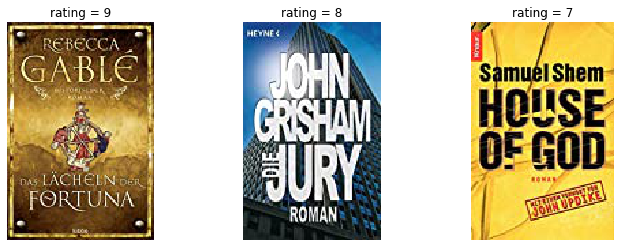

Такие рекомендации


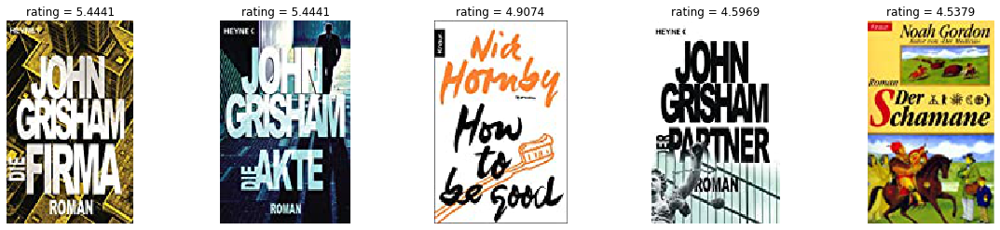

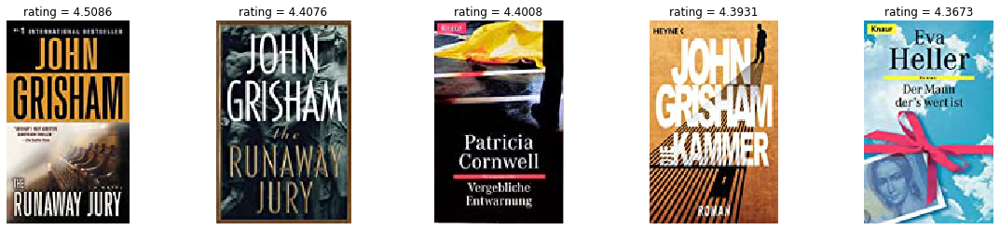

In [49]:
CB_u2i(86583)

Для пользователя, который оценил книги


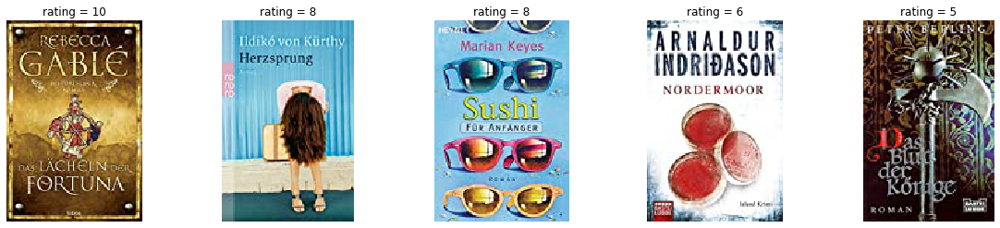

Такие рекомендации


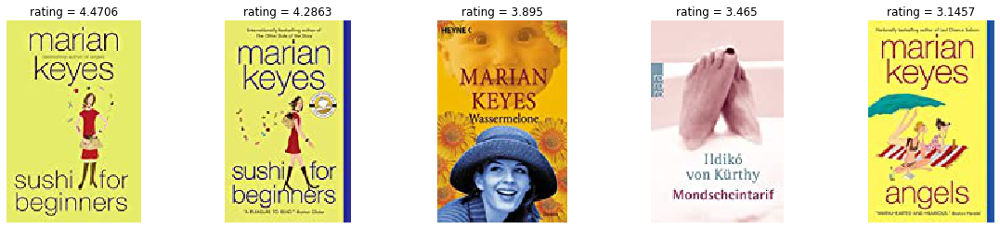

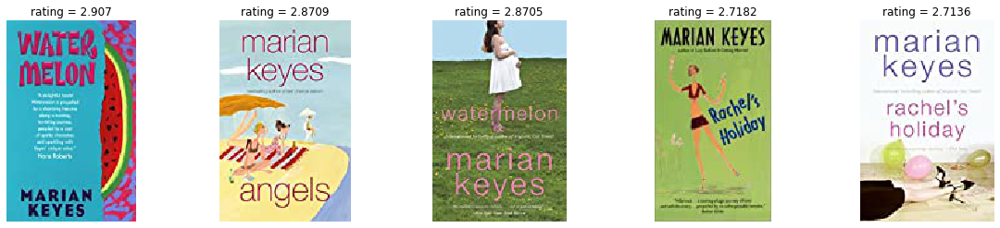

In [50]:
CB_u2i(132500)

Для пользователя, который оценил книги


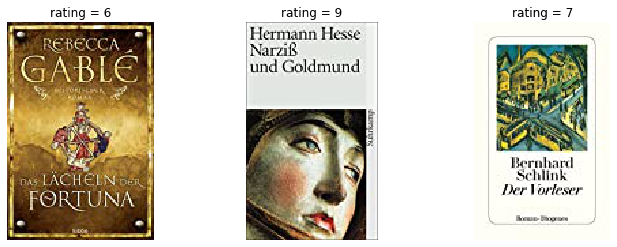

Такие рекомендации


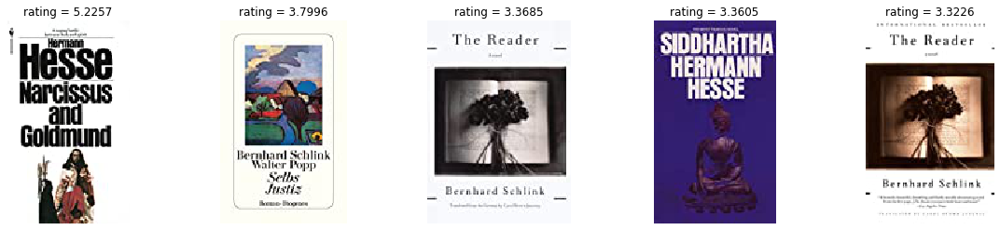

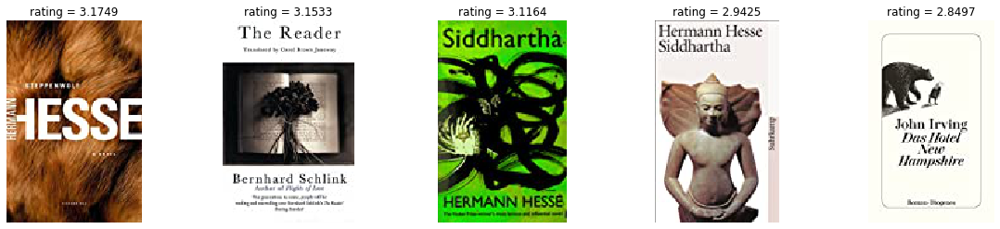

In [51]:
CB_u2i(106534)

Для пользователя, который оценил книги


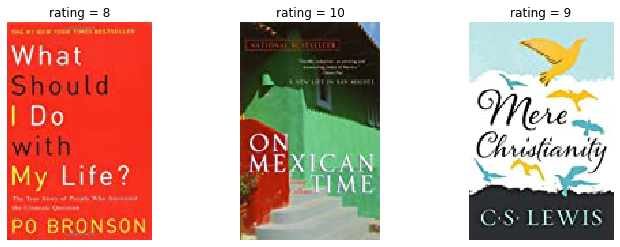

Такие рекомендации


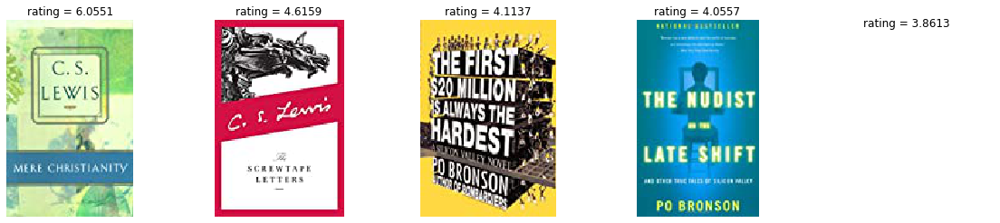

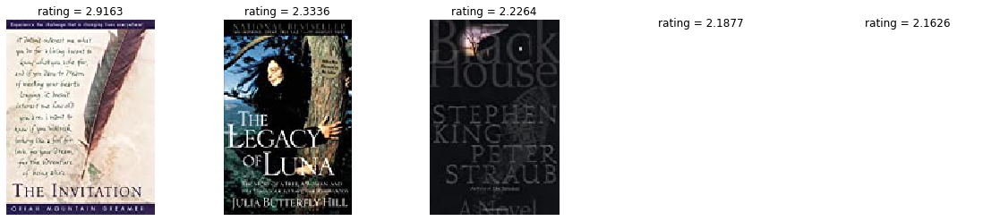

In [52]:
CB_u2i(94153)

Для пользователя, который оценил книги


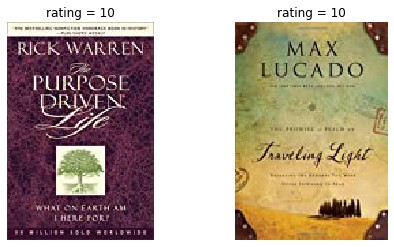

Такие рекомендации


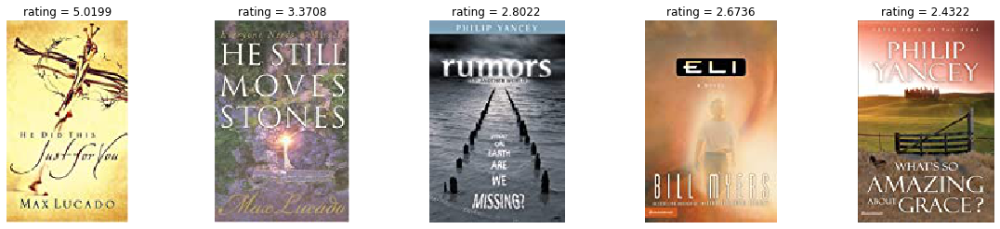

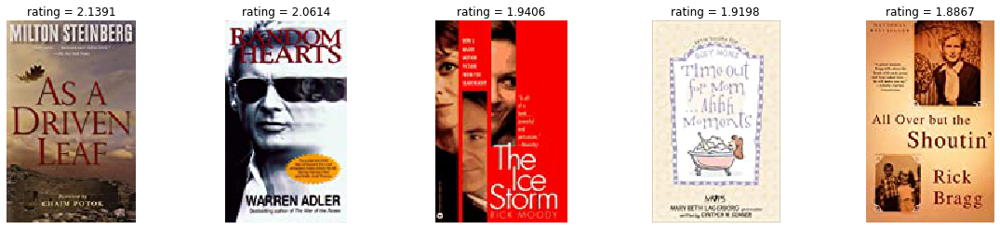

In [53]:
CB_u2i(27551)

## Коллаборативная фильтрация
Коллаборативную фильтрацию реализовывать как на слайде 50 презентации, посоветовав каждому пользователю топ-10 книг с самой высокой оценкой. Сделать рекомендации User-based и Item-based и сравнить.

Для Content-based, Коллаборативной фильтрации, Матричной Факторизации реализовать U2I и I2I рекомендации

In [31]:
csr_rates = csr_rates.toarray()

In [33]:
csr_rates.shape

(10960, 10712)

In [37]:
user_cosine = cosine_similarity(csr_rates, csr_rates)
user_cosine

array([[1., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 0., 1.]])

In [38]:
user_cosine.shape

(10960, 10960)

In [43]:
for user_id in interactions['User-ID'].value_counts().index:
    user = interactions[interactions['User-ID'] == user_id]
    user_rating = user['Book-Rating'].mean()
    index = interactions[interactions['User-ID'] == user_id].index
    interactions.loc[index, 'Average User-Rating'] = user_rating

In [68]:
interactions['dif'] = interactions['Book-Rating'] - interactions['Average User-Rating']

In [186]:
def clb_user_based(user_id):
    Int = interactions[interactions['User-ID'] == user_id]
    r_u_mean = Int['Book-Rating'].mean()
    vid  = Int.vid.iloc[0]
    sim = pd.DataFrame(user_cosine[vid], columns=['measure'])
    sim['vid'] = sim.index
    interac = interactions[['User-ID', 'ISBN', 'picture_url', 'vid', 'product_id', 'dif']]
    ISBNs = Int.ISBN.values
    interac = interac.drop(interac[interac['ISBN'].isin(ISBNs)].index)
    interac = pd.merge(interac, sim, on='vid')
    interac = interac[interac.measure != 0]
    interac = interac[interac.dif != 0]
    interac['mult'] = interac.dif * interac.measure
    df = pd.DataFrame(columns=['picture_url', 'rating', 'product_id'])
    for ISBN in interac.ISBN.value_counts().index:
        I = interac[interac.ISBN == ISBN]
        rating = r_u_mean + (I.mult.sum() / I.measure.sum())
        df.loc[ISBN] = [I.picture_url.values[0], rating, I.product_id.values[0]]
    book_isbns = df.rating.sort_values(ascending=False)[:10].index
    measure = df.rating.sort_values(ascending=False)[:10].values
    product_id_to_url = {}
    for i in interactions[["product_id", "picture_url"]].drop_duplicates().values:
        product_id_to_url[i[0]] = i[1]
    print(u"Для пользователя, который оценил книги")
    rec_imaging(Int.product_id.values, product_id_to_url, Int['Book-Rating'].values)
    print(u"Такие рекомендации")
    rec_imaging(df.loc[book_isbns].product_id.values, product_id_to_url, measure)

Для пользователя, который оценил книги


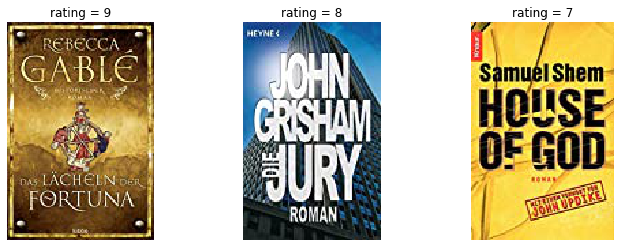

Такие рекомендации


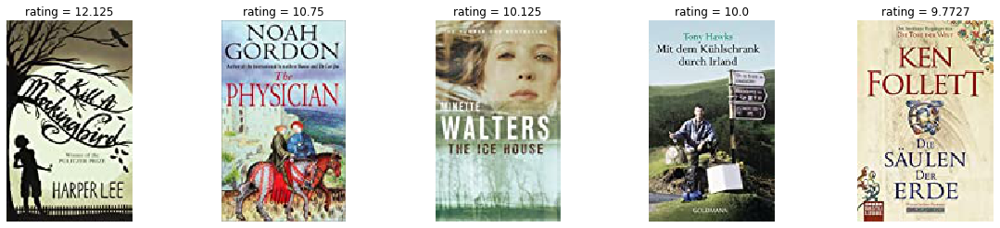

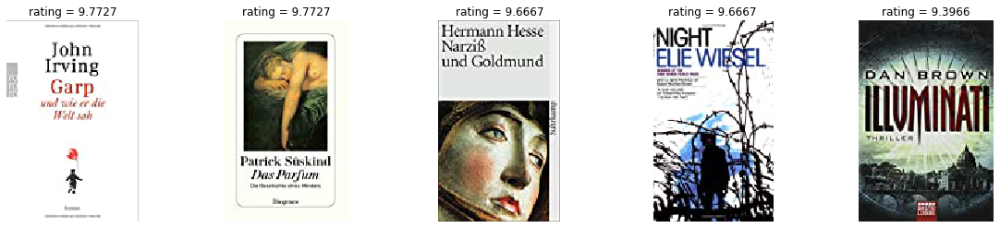

In [187]:
clb_user_based(86583)

Для пользователя, который оценил книги


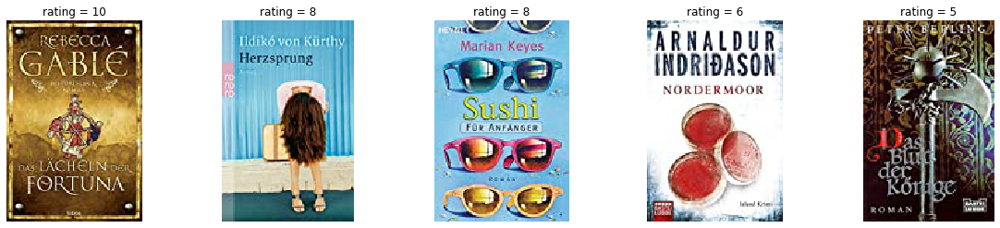

Такие рекомендации


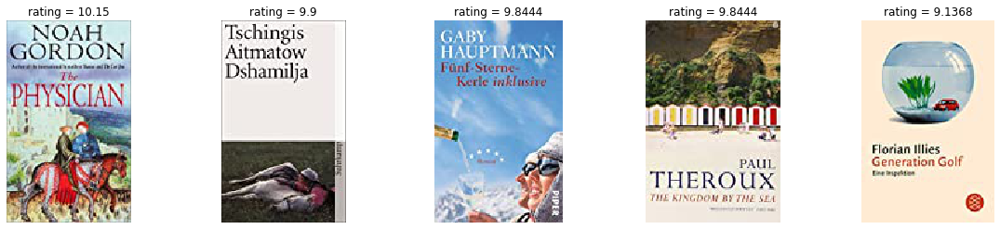

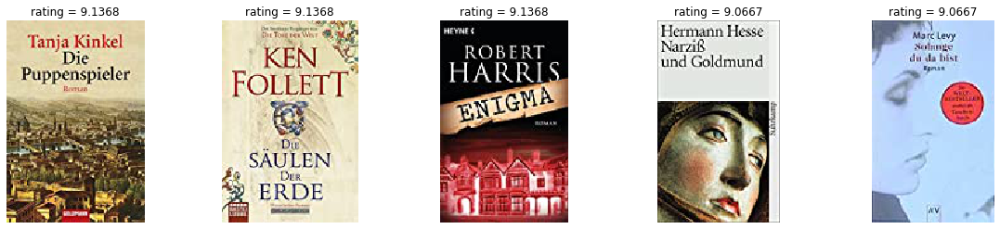

In [188]:
clb_user_based(132500)

Для пользователя, который оценил книги


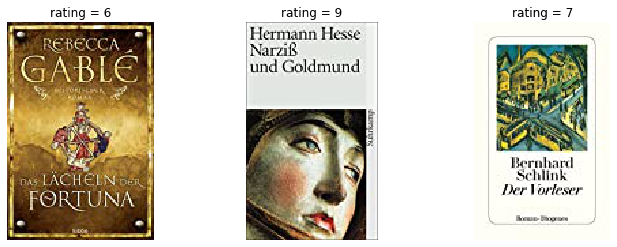

Такие рекомендации


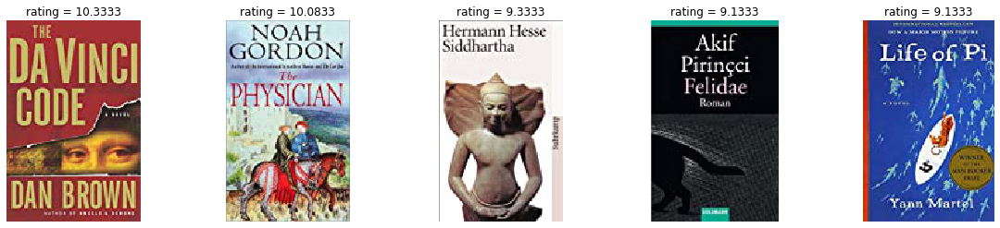

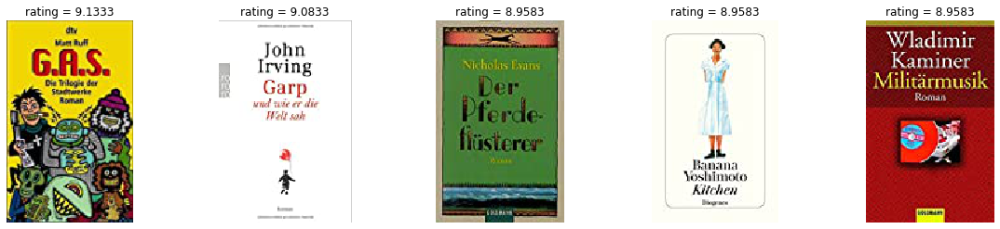

In [189]:
clb_user_based(106534)

Для пользователя, который оценил книги


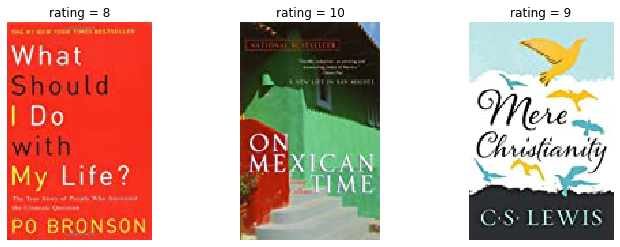

Такие рекомендации


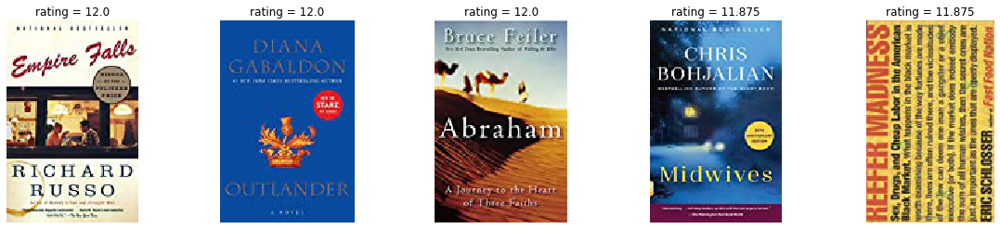

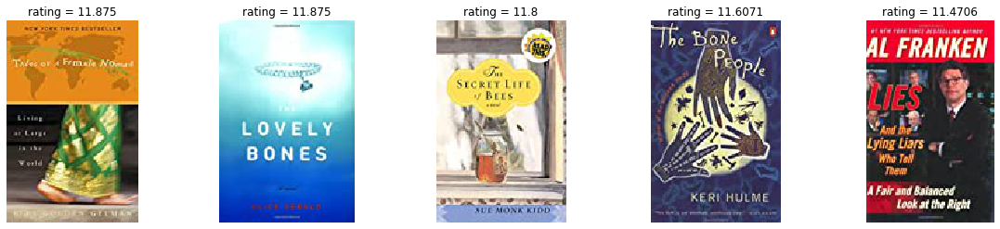

In [151]:
clb_user_based(94153)

Для пользователя, который оценил книги


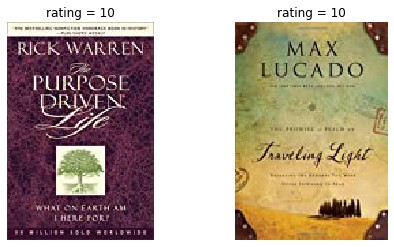

Такие рекомендации


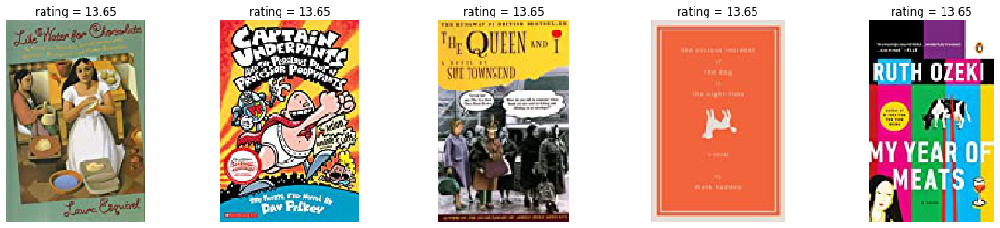

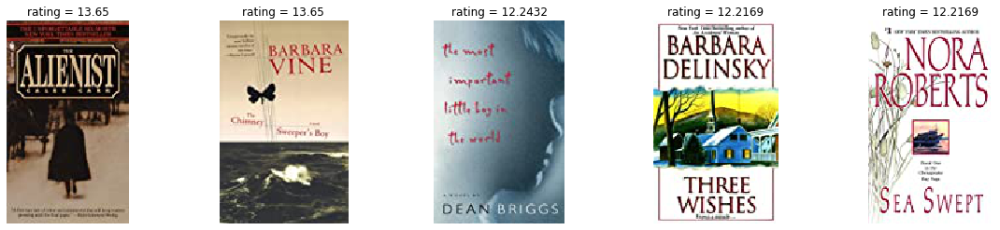

In [152]:
clb_user_based(27551)

In [155]:
item_cosine = cosine_similarity(csr_rates.T, csr_rates.T)
item_cosine

array([[1., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 0., 1.]])

In [216]:
from scipy.sparse import spdiags

Обнуляю диагональ, чтобы исключить ее из рекомендаций:

In [220]:
diag = spdiags(-item_cosine.diagonal(), [0], *item_cosine.shape, format='csr')
item_cosine = item_cosine + diag
item_cosine

matrix([[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]])

In [277]:
def clb_ib(user_id):
    Int = interactions[interactions['User-ID'] == user_id]
    vid = Int.vid.values[0]
    rating = csr_rates[vid]
    x = item_cosine.dot(rating) # поиск похожих книг
    x[0, rating.nonzero()] = 0 # обнулил книги, которые пользователь уже оценил
    df = pd.DataFrame(x.T, columns=['measure'])
    index = df.measure.sort_values(ascending=False)[:10].index
    measure = df.measure.sort_values(ascending=False)[:10].values
    product_id_to_url = {}
    for i in interactions[["product_id", "picture_url"]].drop_duplicates().values:
        product_id_to_url[i[0]] = i[1]
    print(u"Для пользователя, который оценил книги")
    rec_imaging(Int.product_id.values, product_id_to_url, Int['Book-Rating'].values)
    print(u"Такие рекомендации")
    rec_imaging(index, product_id_to_url, measure)

Для пользователя, который оценил книги


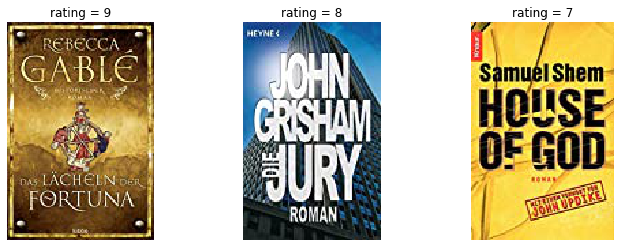

Такие рекомендации


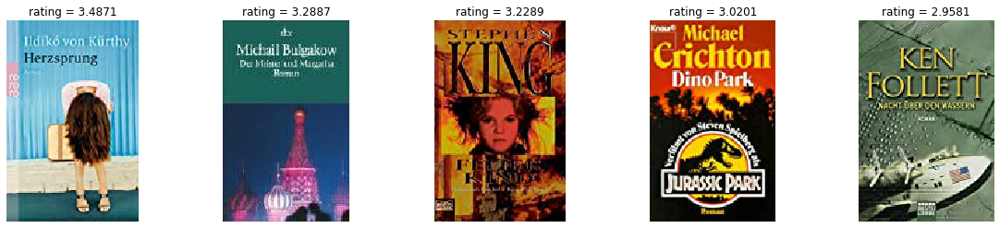

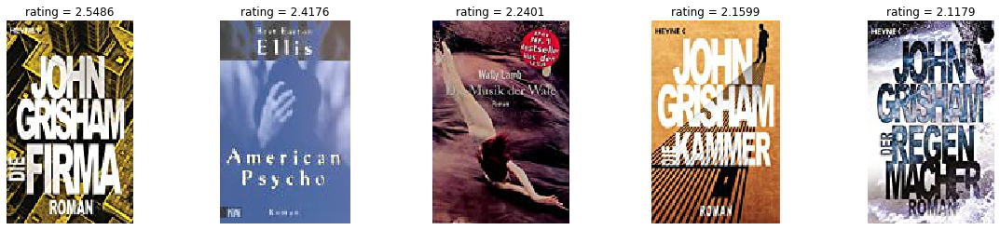

In [278]:
clb_ib(86583)

Для пользователя, который оценил книги


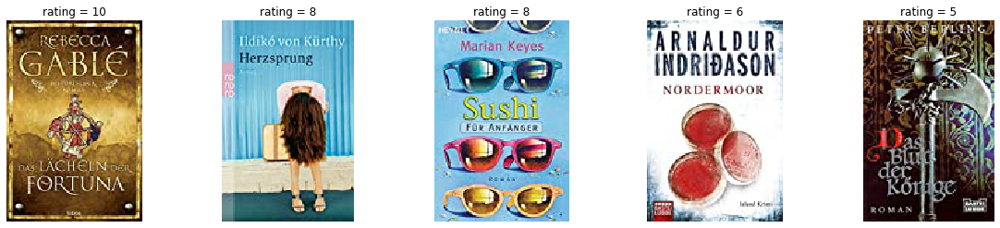

Такие рекомендации


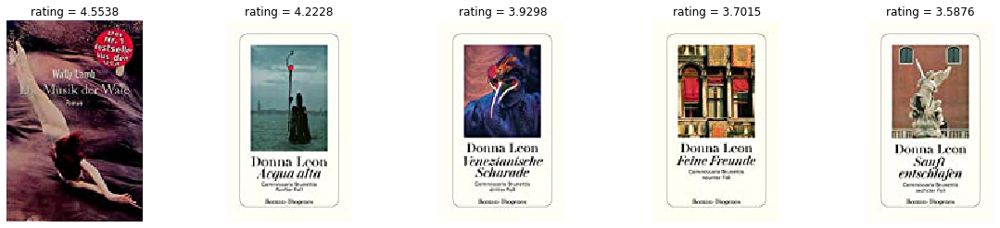

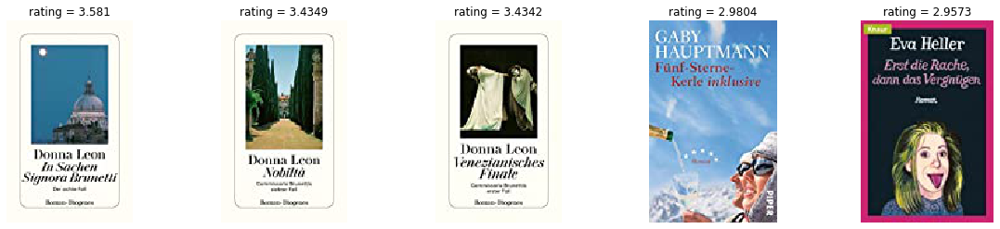

In [279]:
clb_ib(132500)

Для пользователя, который оценил книги


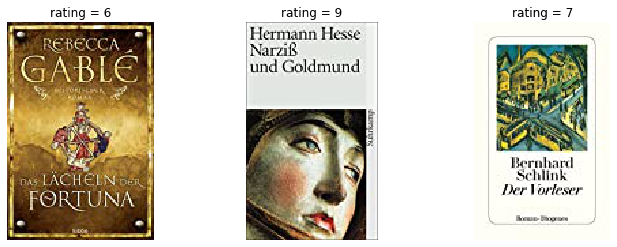

Такие рекомендации


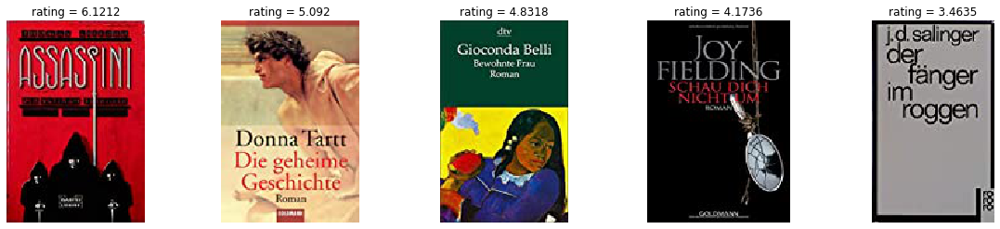

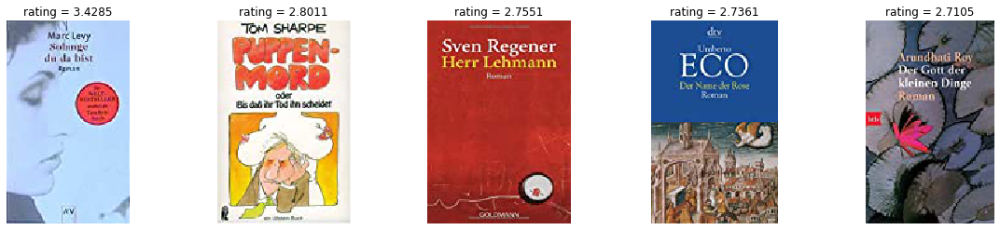

In [280]:
clb_ib(106534)

Для пользователя, который оценил книги


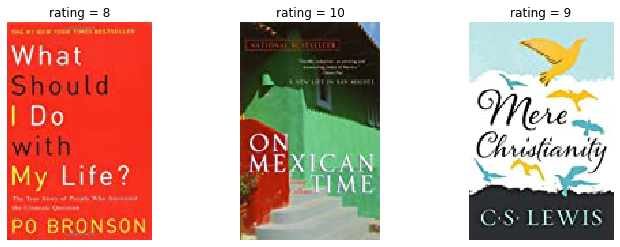

Такие рекомендации


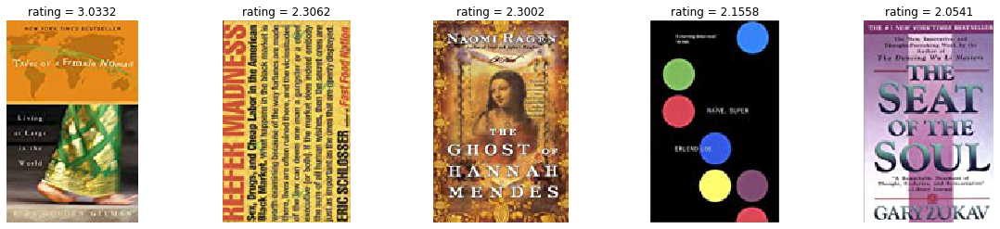

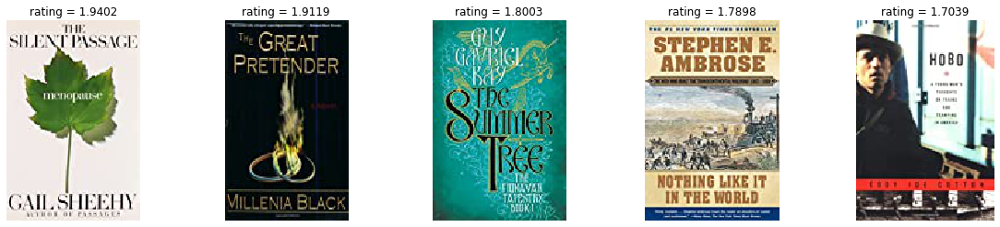

In [281]:
clb_ib(94153)

Для пользователя, который оценил книги


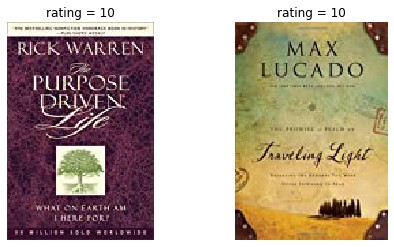

Такие рекомендации


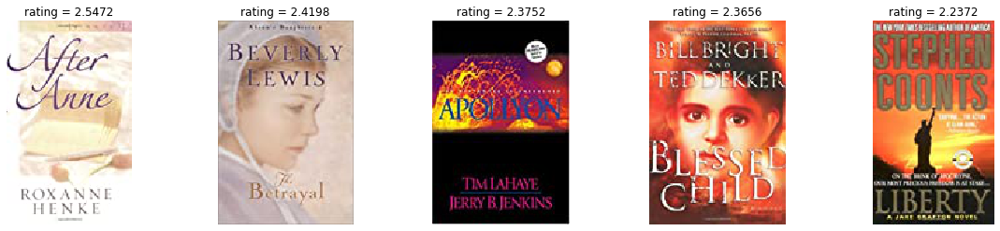

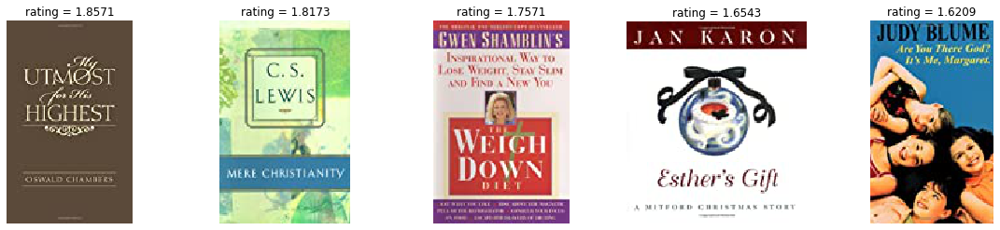

In [282]:
clb_ib(27551)

Два подхода коллаборативной фильтрации выдают практически разные рекомендации (в некоторых случаях присутствует пара-тройка одинаковых книг). Однако оба метода дают адекватный результат, так как совпадают языки.

## Матричная факторизация
Для Content-based, Коллаборативной фильтрации, Матричной Факторизации реализовать U2I и I2I рекомендации

In [283]:
from scipy.sparse.linalg import svds

In [342]:
U, S, V = svds(csr_rates.astype(float), k=100)
user_embs = U
items_embs = V.T

In [343]:
def MF_I2I(ISBN):
    j = interactions[interactions.ISBN == ISBN].product_id.values[0]
    metrics = cosine_similarity([items_embs[j]], items_embs)
    product_id_to_url = {}
    for i in interactions[["product_id", "picture_url"]].drop_duplicates().values:
        product_id_to_url[i[0]] = i[1]
    print(u"Для товара")
    rec_imaging([j], product_id_to_url)
    print(u"Такие рекомендации")
    rec_imaging(np.argsort(-metrics)[0][1:11], product_id_to_url, -np.round(np.sort(-metrics)[0][1:11], 4))

Для товара


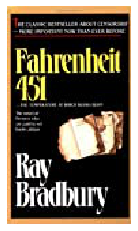

Такие рекомендации


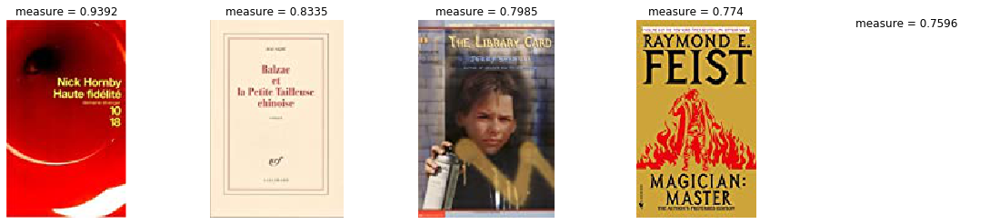

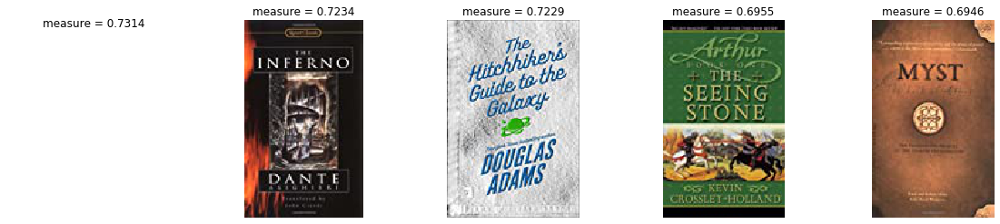

In [344]:
MF_I2I('0345342968')

Для товара


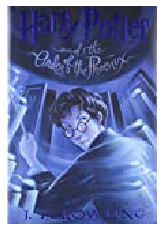

Такие рекомендации


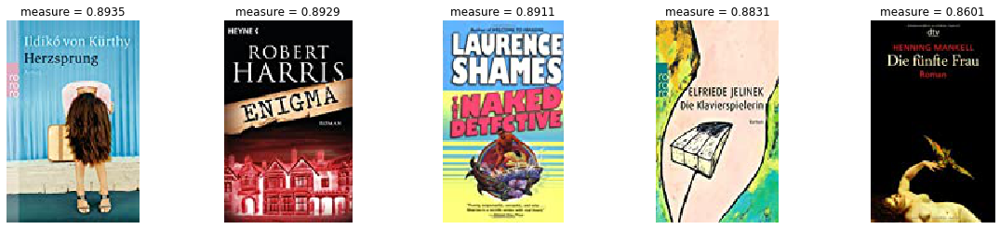

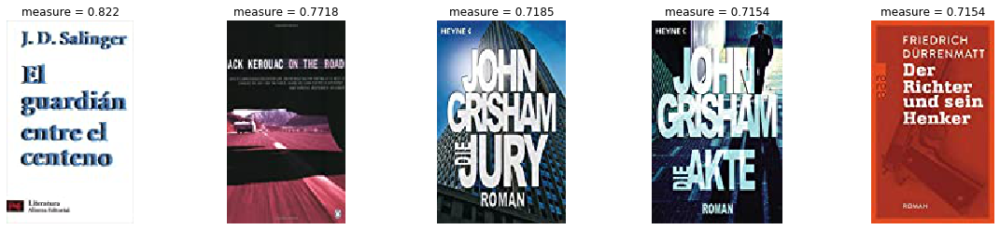

In [345]:
MF_I2I('043935806X')

Для товара


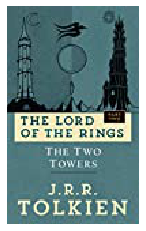

Такие рекомендации


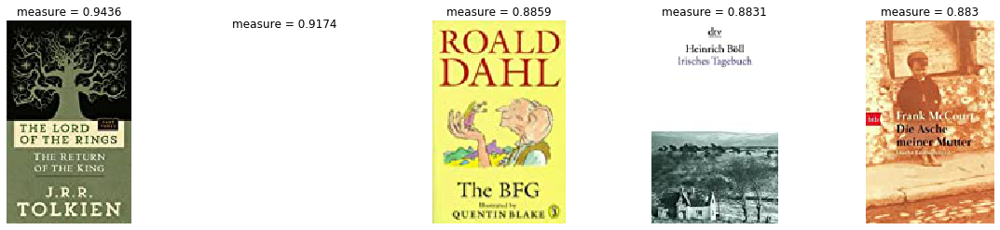

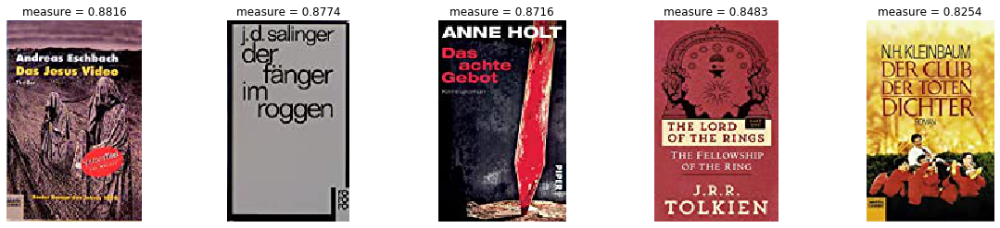

In [346]:
MF_I2I('0345339711')

Для товара


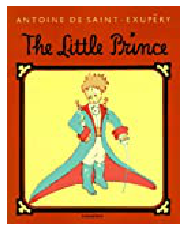

Такие рекомендации


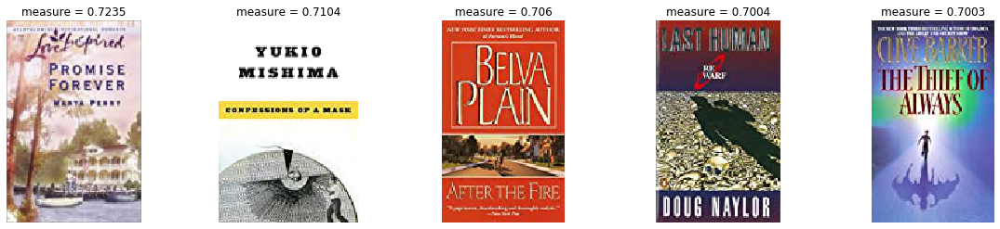

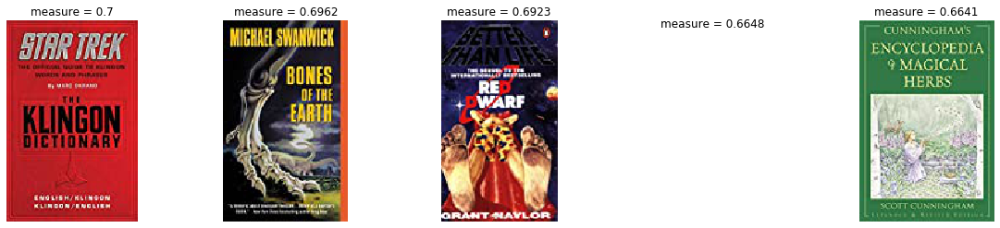

In [347]:
MF_I2I('0156465116')

Для товара


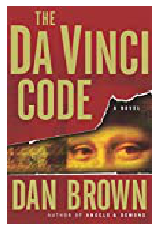

Такие рекомендации


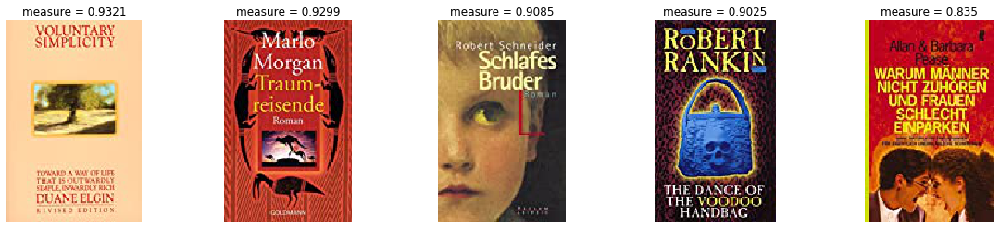

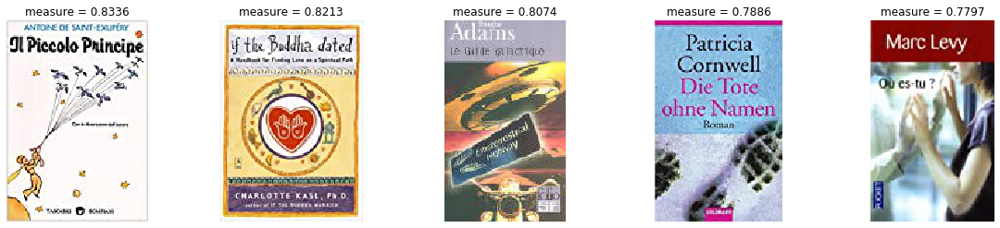

In [348]:
MF_I2I('0385504209')

In [402]:
def MF_U2I(user_id):
    Books = interactions[interactions['User-ID'] == user_id].product_id.values
    metrics = pd.Series([], dtype=pd.StringDtype())
    for j in Books:
        cosine = pd.Series(cosine_similarity([items_embs[j]], items_embs).reshape(items_embs.shape[0],))
        cosine = cosine.sort_values(ascending=False)[1:11]
        metrics = metrics.append(cosine)
    product_id_to_url = {}
    for i in interactions[["product_id", "picture_url"]].drop_duplicates().values:
        product_id_to_url[i[0]] = i[1]
    print(u"Для пользователя, который оценил книги")
    rec_imaging(Books, product_id_to_url)
    print(u"Такие рекомендации")
    metrics = metrics.sort_values(ascending=False)[:10]
    rec_imaging(metrics.index, product_id_to_url, metrics.values)

Для пользователя, который оценил книги


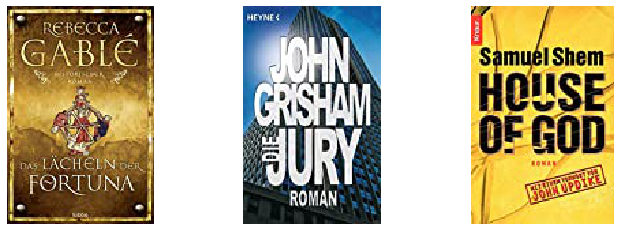

Такие рекомендации


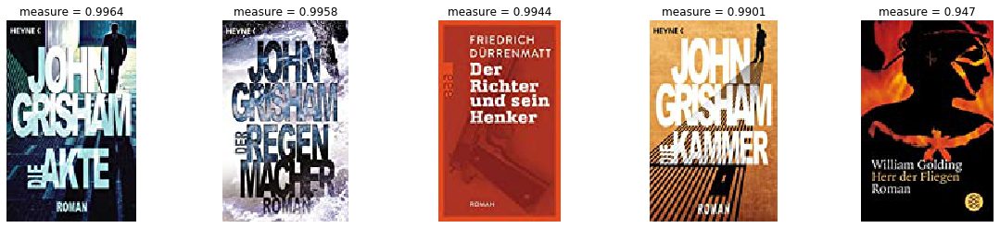

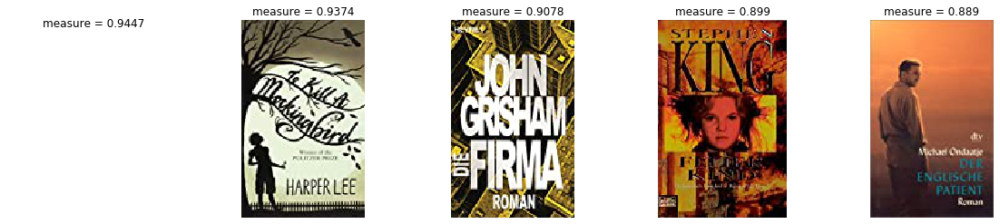

In [403]:
MF_U2I(86583)

Для пользователя, который оценил книги


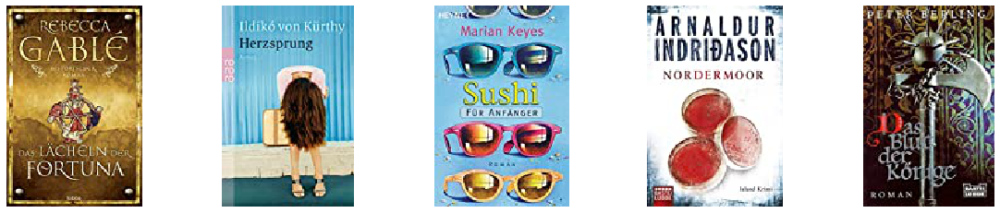

Такие рекомендации


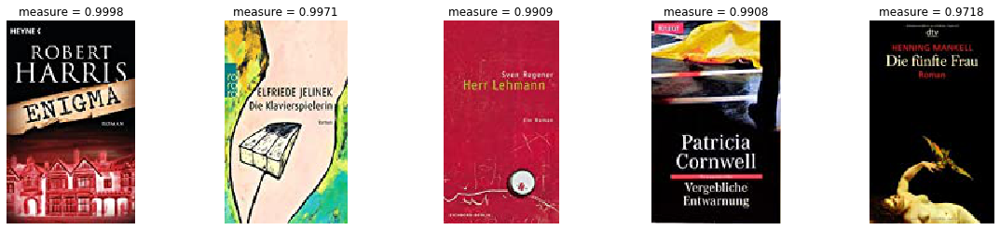

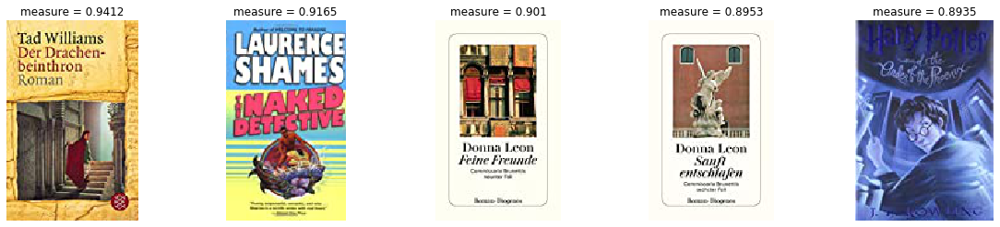

In [404]:
MF_U2I(132500)

Для пользователя, который оценил книги


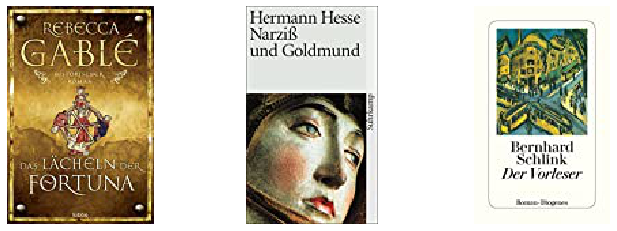

Такие рекомендации


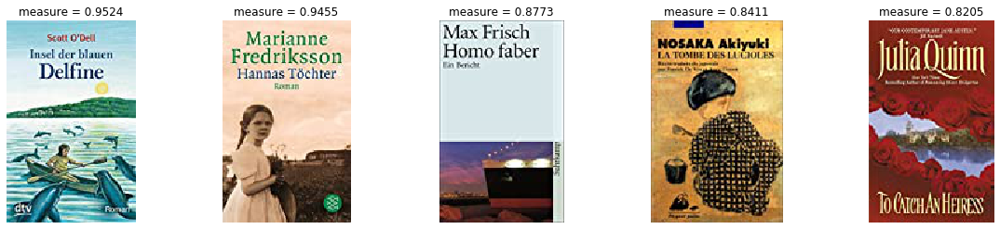

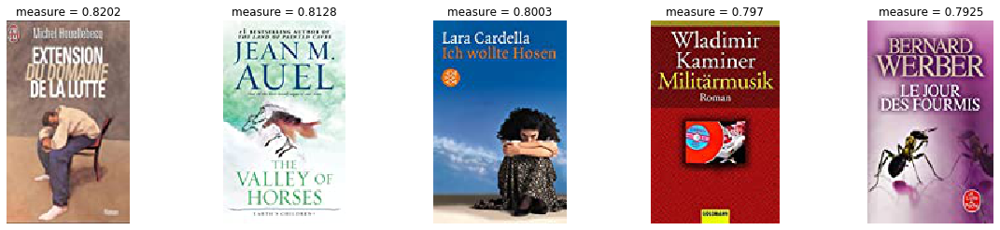

In [405]:
MF_U2I(106534)

Для пользователя, который оценил книги


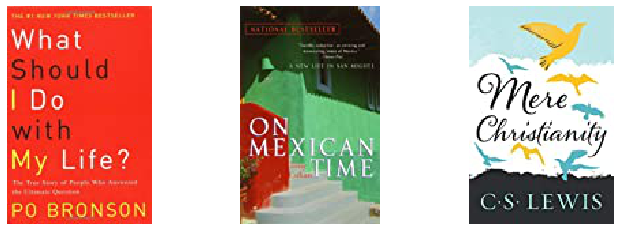

Такие рекомендации


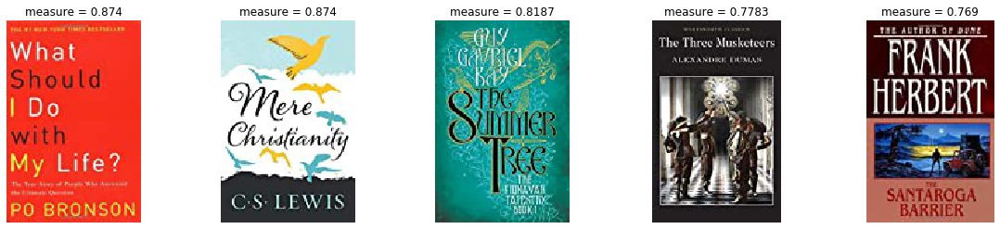

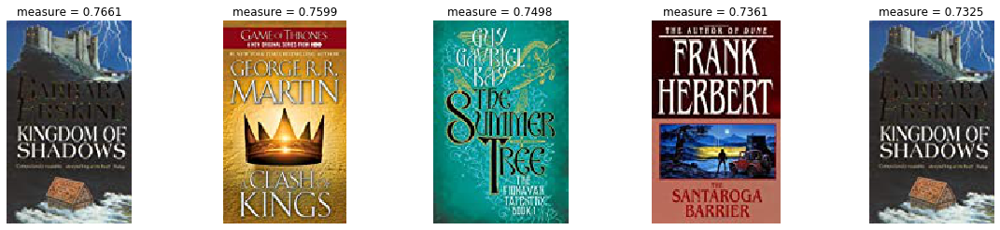

In [406]:
MF_U2I(94153)

Для пользователя, который оценил книги


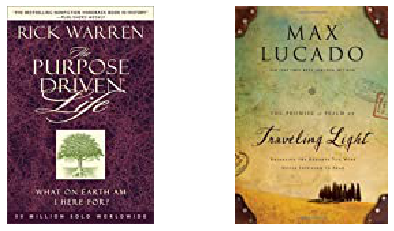

Такие рекомендации


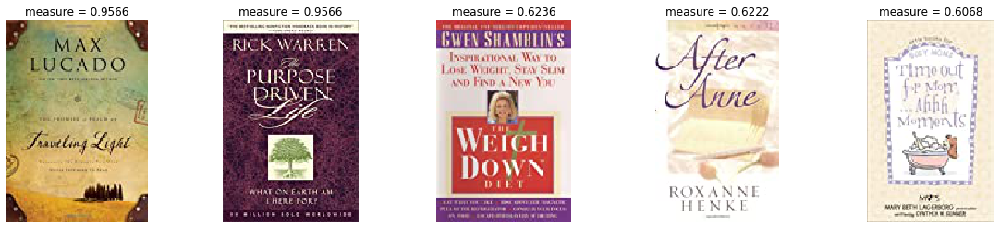

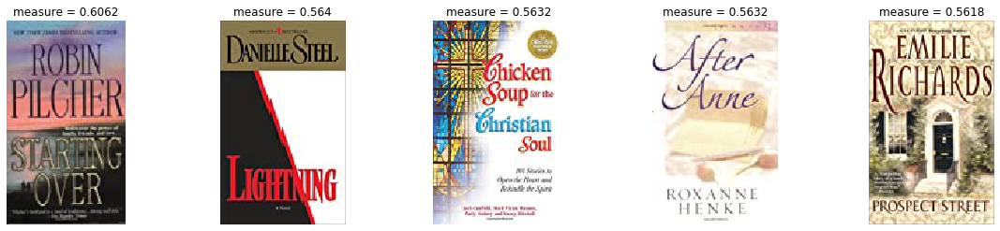

In [407]:
MF_U2I(27551)